# **Quantitating Cis-Regulatory Module Activity via Image Analysis in Python**


## **Introduction**  
This notebook serves as a tool stack for image analysis using Python. Steps 0-9 allow you to perform data cleaning and organization steps, as well as test and optimize common image analysis tasks. If you would like to skip the optimization, you can begin with the complete, stream-lined workflow in step 10. Keep in mind the workflow in step 10 is tailored to our dataset and may not be optimal for other datasets. 


## Step 0: Load Dependencies

> This section loads the modules used in this notebook. 

*   [OS](https://docs.python.org/3/library/os.html) interfaces with the operating system for tasks such as file handling.
*   [Re](https://docs.python.org/3/library/re.html) facilitates the use of regular expressions (Regex) with Python.
*   [NumPy](https://www.numpy.org/) an array manipulation library, used for linear algebra, Fourier transform, and random number capabilities.
*   [Matplotlib](https://matplotlib.org/) generates figures and provides a graphical user interface toolkit.
*   [Skimage](https://scikit-image.org/) (Scikit-Image) supports image processing applications in Python.
*   [CV2](https://opencv.org/) (the current version of OpenCV) performs computer vision tasks.
*   [RoiPoly](https://github.com/jdoepfert/roipoly.py) a simple widget to interactively draw an ROI on an image.
*   [Pandas](https://pandas.pydata.org/) for data manipulation and analysis.
*   [Seaborn](https://seaborn.pydata.org/) a data visualization library that is based off of and interfaces with Matplotlib.
*   [Statannotations.Annotator](https://github.com/trevismd/statannotations) runs a few common tests and display them on plots.
*   [SciPy](https://docs.scipy.org/doc/scipy/tutorial/general.html) SciPy builds on NumPy with additional algorithms and commands for manipulating and visualizing data.

>A special note on Computer Vision Libraries: While CV2 may be more popular than Skimage, CV2 reads images in BGR format instead of the standard RGB. It is extremely important to recognize what colorspace is used by the computer vision tools you are using. Additionally, I highly recommend the tutorials at [Datacarpentry](https://datacarpentry.org/image-processing/) for Skimage and image processing in general.

>Other useful libraries/tools that did not make it into the final version of this notebook:

*   [PIL/Pillow](https://pypi.org/project/Pillow/) Pillow is a more user-friendly, updated fork of PIL: the original Python Imaging Library.
*   [SamuROI](https://github.com/samuroi/SamuROI) a widget for scientific analysis of image ROIs, particularly for videos and TIFFs.
*   [CSV](https://docs.python.org/3/library/csv.html) for working with csv files in Python.
*   [TensorFlow](https://www.tensorflow.org/) a machine learning library that integrates well with NumPy

In [ ]:
# Library installation, this notebook works with the following versions
# Python==3.9.16 which includes itertools, math, os, shutil, and modules
conda install glob2==0.7
conda install matplotlib==3.5.1
conda install matplotlib-inline==0.1.6
#numpy = 1.23.5 
pip install opencv-contrib-python #==4.6.0.66 
#pandas = 1.5.3
conda install regex==2022.7.9
pip install roipoly # 0.5.4
conda install scikit-image==0.19.3
#scipy = 1.10.0
conda install seaborn==0.12.2
pip install statannotations #=0.4.4

In [1]:
import os
import shutil
import re
import numpy as np
import matplotlib.pylab as plt  # Roipoly needs Matplotlib 3.5.1
from skimage import io, filters, restoration
from skimage.color import rgb2gray
import cv2
from roipoly import RoiPoly
import pandas as pd
from matplotlib.path import Path

## Step 1: File Renaming and Organization
>This section uses Regular Expressions (Regex) to ensure all file names are uniform. 

To prepare the data for further processing this code:
* Impliments a uniform naming system (sometimes this changes over time)
* Removes special characters and spaces from file names
* Avoids unnecessary layers of subdirectories
* Adds experiment date and contruct name to filenames for later selection

Turn your filename pattern into Regex using [Regex Generator](https://regex-generator.olafneumann.org/) and [Regex101](https://regex101.com/).

In [46]:
def rename_files(path, oldstr, newstr):
    os.chdir(path)
    for root, dirs, files in os.walk(path, topdown=False):
        for name in files:
            if oldstr in name:
                newname = re.sub(oldstr, newstr, name)
                os.rename(os.path.join(root, name),
                        os.path.join(root, newname))

# path = #your path here
# rename_files(path, 'embro', 'embryo')

## Step 2: Select Files and Make Figures
>Set the current working directory and make a figure of all the embryos of a given mutant.

In [2]:
# Select the three images for each embryo from the parent directory
def select_embryos(path, mut_name, RFPexp='05s', GFPexp='2s'):
    embryos = []
    # Changes current directory to the given parent directory of images
    os.chdir(path)
    # Defines the Regex pattern files must match, to exclude other files in the directories
    regex = re.compile(
        r'^(\d{4})-(\d{2})-(\d{2})_E(\d{2})_(.+)_(.+)_RLD_63x_([a-zA-Z]+)_([0-9]+)s\.(jpg|JPG|png|PNG|tif|TIF)$')    
    # Searches all directories and subdirectories starting at the lowest level
    for root, subdirs, files in os.walk(path):
        for name in files:
            # Applies Regex pattern and filters for the given mutant (treatment group)
            if regex.match(name) and (mut_name in name):
                # Selects the Light image or the RFP or GFP of the given exposure time
                if ('Light' in name) or ('RFP' in name and RFPexp in name) or ('GFP' in name and GFPexp in name):
                    # Recreates the filepath of selected files
                    filepath = os.path.join(root, name)
                    # Checks files for exclusion flags
                    if ('_excld' not in filepath) and ('morphexcld' not in filepath) and ('redexcld' not in filepath) and ('autofluor' not in filepath):
                        embryos.append(filepath)
                        print(name)
    return embryos


path = os.getcwd() #your path here
embryos = select_embryos(path, 'cZRS_WT', '05s', '2s')
# Print total number of Embryos for N count and verify that three files for each embryo have been found
print('Number of embryos found: ' + str(len(embryos)/3))

# destination_path = #your path here
# for e in embryos:
#     shutil.copy2(e, destination_path) #copy2 also copies the file metadata

2020-11-11_E03_cZRS_WT_RLD_63x_GFP_2s.jpg
2020-11-11_E03_cZRS_WT_RLD_63x_Light_05s.jpg
2020-11-11_E03_cZRS_WT_RLD_63x_RFP_05s.jpg
2021-02-01_E04_cZRS_WT_RLD_63x_GFP_2s.jpg
2021-02-01_E04_cZRS_WT_RLD_63x_Light_05s.jpg
2021-02-01_E04_cZRS_WT_RLD_63x_RFP_05s.jpg
2023-01-17_E24_cZRS_WT_RLD_63x_GFP_2s.jpg
2023-01-17_E24_cZRS_WT_RLD_63x_Light_05s.jpg
2023-01-17_E24_cZRS_WT_RLD_63x_RFP_05s.jpg
Number of embryos found: 3.0


Optional: make a figure of the images for visual inspection

Total Number of Embryos: 3.0


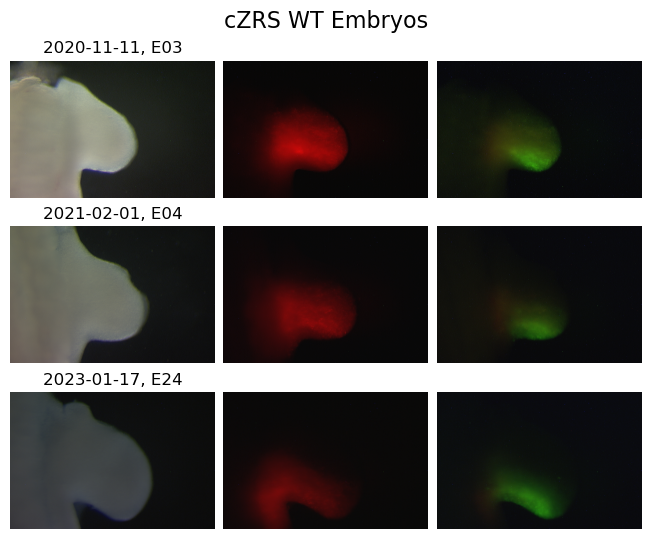

In [3]:

def make_figure(elist, ftitle):
    rows = len(elist)
    axes = []
    width, height = plt.rcParams.get('figure.figsize')
    fig = plt.figure(constrained_layout=True, figsize=(width, len(elist)*1.5))
    fig.suptitle(ftitle + ' Embryos', fontsize=16)
    r=0
    for i, x in enumerate(elist):
        if 'Light' in x:
            img = io.imread(x)
            axes.append(fig.add_subplot(rows, 3, r+1))
            # The split argument divides the image name up at every underscore, the number(s) in brackets calls the column starting at 0
            # Regex to remove brackets and quotes
            axes[-1].set_title(re.sub(r'[\'\']', '', (str((x.split('\\')[-1]).split('_')[0:2])).strip('[]')))
            # Since these are pictures we don't need tick marks
            plt.axis('off')
            plt.imshow(img, aspect='auto')
            r += 3
    r=1
    for i, x in enumerate(elist):
        if 'RFP' in x:
            img = io.imread(x)
            axes.append(fig.add_subplot(rows, 3, r+1))
            plt.axis('off')
            plt.imshow(img, aspect='auto')
            r += 3
    r=2
    for i, x in enumerate(elist):
        if 'GFP' in x:
            img = io.imread(x)
            axes.append(fig.add_subplot(rows, 3, r+1))
            plt.axis('off')
            plt.imshow(img, aspect='auto')
            r += 3
    print('Total Number of Embryos: ' + str(rows/3))
    plt.show()


make_figure(embryos, 'cZRS WT')


## Step 3: Histograms
>Visualize the pixel data to identify interesting image regions, aid in setting thresholds (later), and check for saturation.

In [5]:
# Iterator Function, to simplify future steps
def iterator(function, elist):
    for x in elist:
        image = io.imread(x)
        function(image)

### Create a histogram that shows each of the RGB channels separately

More on [Matplotlib Histograms](https://matplotlib.org/stable/gallery/statistics/hist.html)

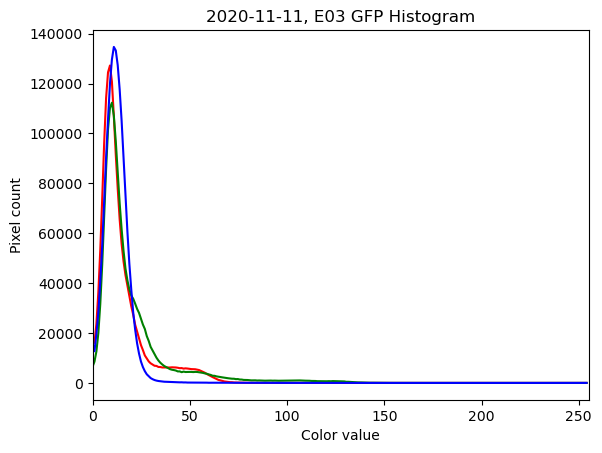

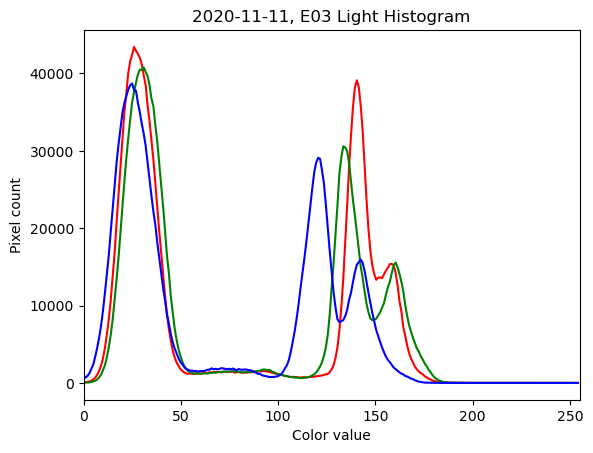

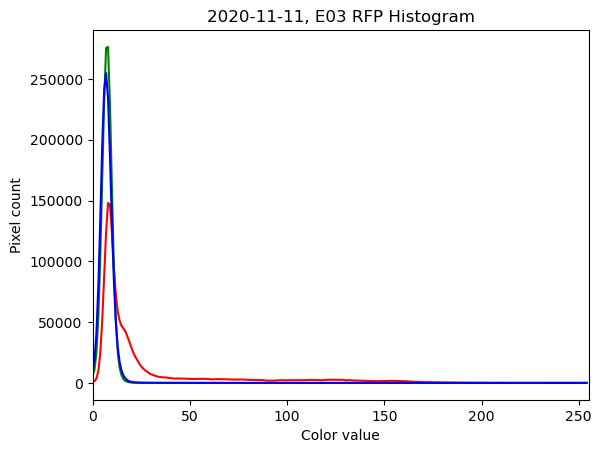

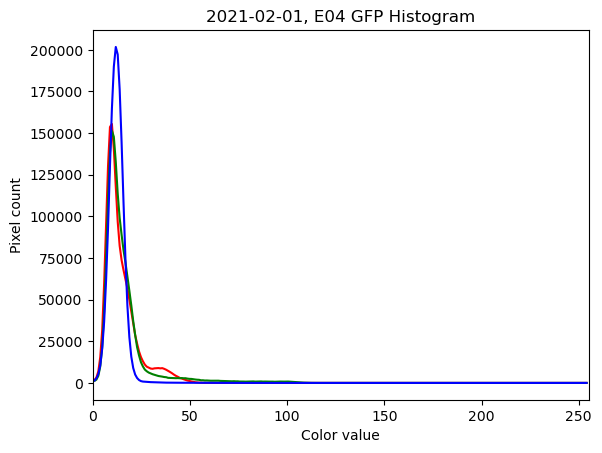

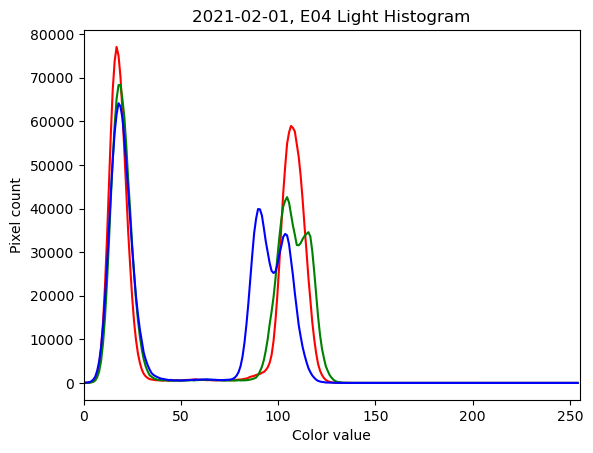

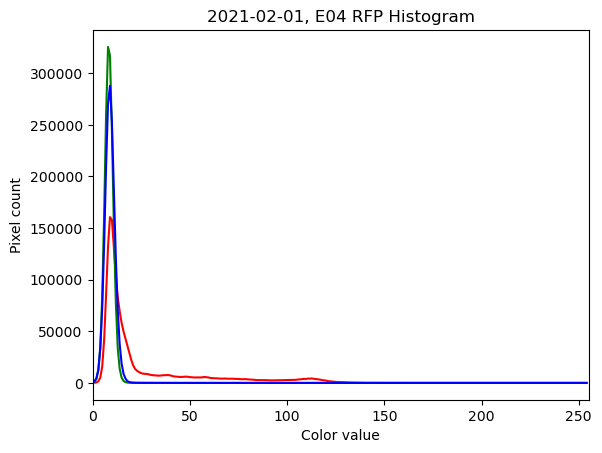

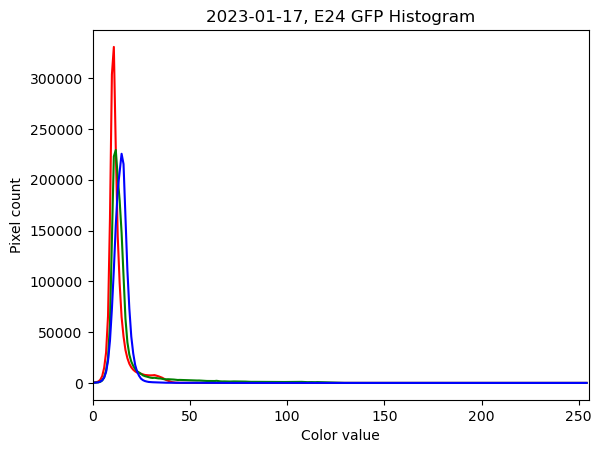

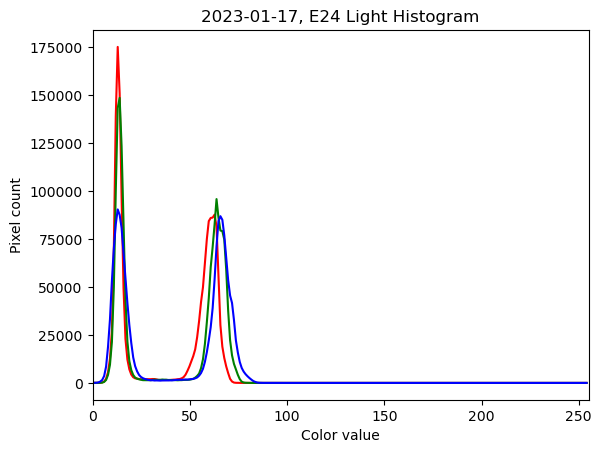

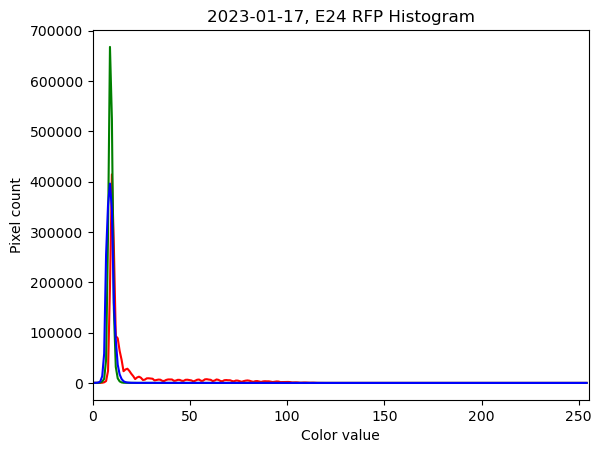

In [4]:
def histogram_rgb(elist):
    for x in elist:
        image = io.imread(x)
        color = ('r', 'g', 'b')  # Tuple to select colors of each channel line
        for i, col in enumerate(color):
            histogram, bin_edges = np.histogram(image[:, :, i], bins=256, range=(0, 255))
            plt.plot(bin_edges[0:-1], histogram, color=col)
            plt.xlim([0, 255])  # 255 instead of 256 because 0-255 has 256 values.
        plt.title(re.sub(r'[\'\']', '', (str((x.split('\\')[-1]).split('_')[0:2])).strip('[]')+ ' ' +(str((x.split('\\')[-1]).split('_')[6])).strip('[]'))+ ' Histogram')
        plt.xlabel('Color value')
        plt.ylabel('Pixel count')
        plt.show()


histogram_rgb(embryos)


## Step 4: Bleed-Through Removal
>Because the RFP often bleeds through the green filter and can be seen in the GFP image, we will subtract the red channel values from the GFP image so they will not skew the downstream quantification.

### Color Spaces

>Name the methods here "For HSV, Hue range is [0,179], Saturation range is [0,255] and Value range is [0,255]. Different softwares use different scales. So if you are comparing OpenCV values with them, you need to normalize these ranges." 
*  [Method1](https://opencv24-python-tutorials.readthedocs.io/en/latest/py_tutorials/py_imgproc/py_colorspaces/py_colorspaces.html#:~:text=HSV.,determines%20the%20type%20of%20conversion.&text=For%20HSV%2C%20Hue%20range%20is,Value%20range%20is%20%5B0%2C255%5D.) for data manipulation and analysis.

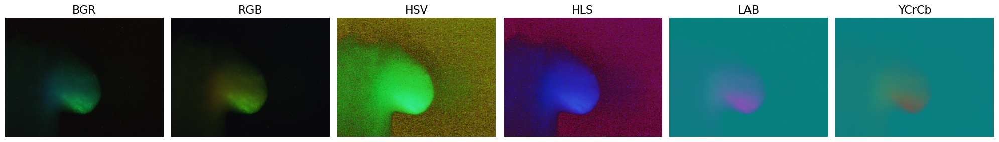

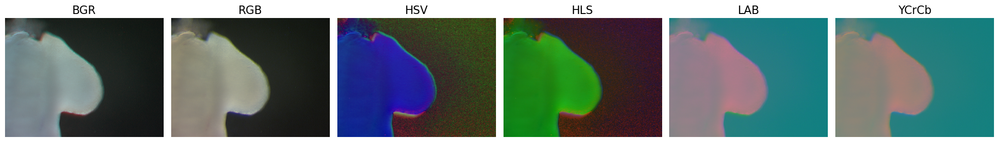

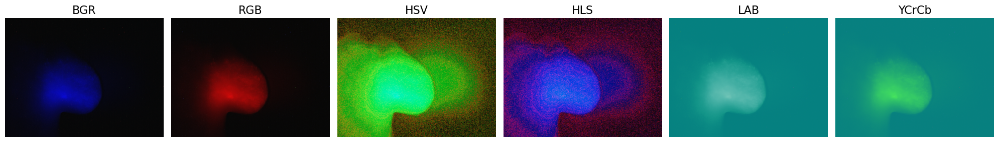

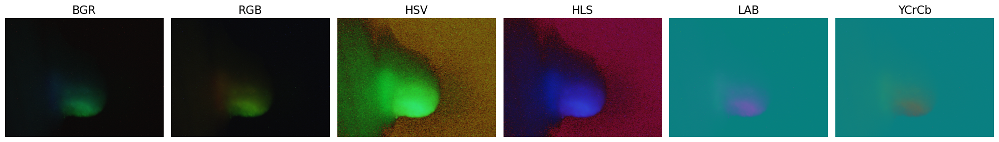

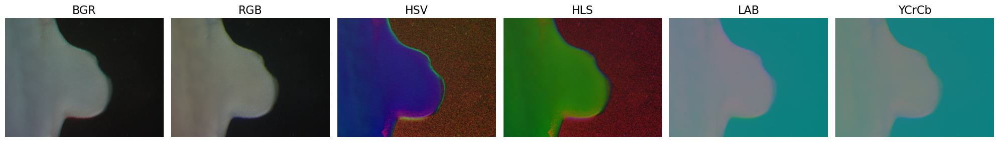

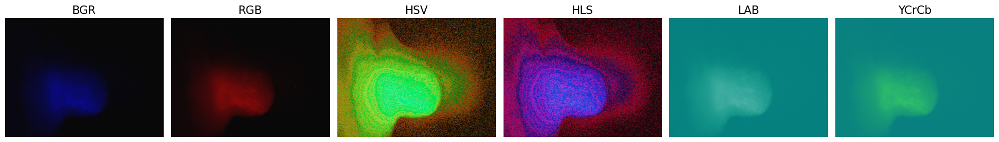

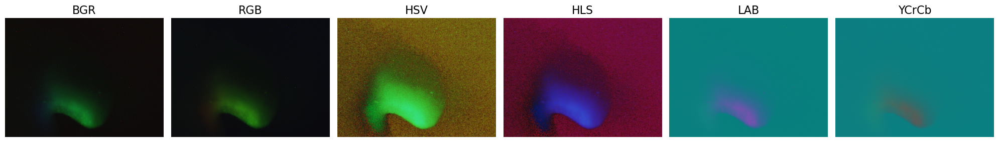

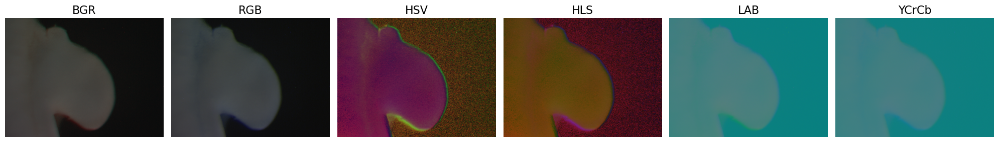

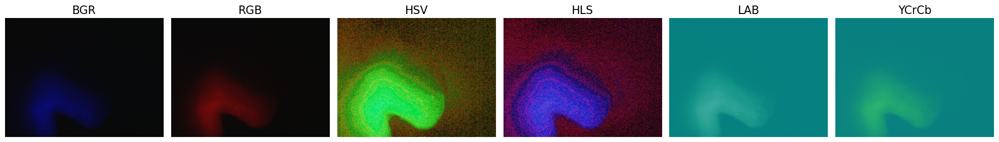

In [5]:

def display_colorspaces(elist):
    for x in elist:
        img_bgr = cv2.imread(x) 
        img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
        img_hsv = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2HSV)
        img_hls = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2HLS)
        img_lab = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2LAB)
        img_ycrcb = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2YCrCb)
        
        fig, axes = plt.subplots(1, 6, figsize=(20, 5), sharex=True, sharey=True)
        # fig.suptitle('Color Spaces', fontsize=16)
        ims=[img_bgr, img_rgb, img_hsv, img_hls, img_lab, img_ycrcb]
        titles = ['BGR','RGB', 'HSV', 'HLS', 'LAB', 'YCrCb']
        ax = axes.ravel()
        for i, im in enumerate(ims):
            ax[i].imshow(im)
            ax[i].set_title(titles[i], fontsize=16)
            ax[i].axis('off')
        fig.tight_layout()

display_colorspaces(embryos)

Determine the HSV hue range for 'Red'

In [ ]:
#When we're not dealing with CV2, the channels are Red = 0, Green = 1, and Blue = 2
#For CV2 the channels are Blue = 0, Green = 1, and Red = 2

red = np.uint8([[[0,0,255]]])
hsv_red = cv2.cvtColor(red,cv2.COLOR_BGR2HSV)
print(hsv_red)


[[[  0 255 255]]]


Now take [H-10, 100, 100] and [H+10, 255, 255] as lower bound and upper bounds respectively.

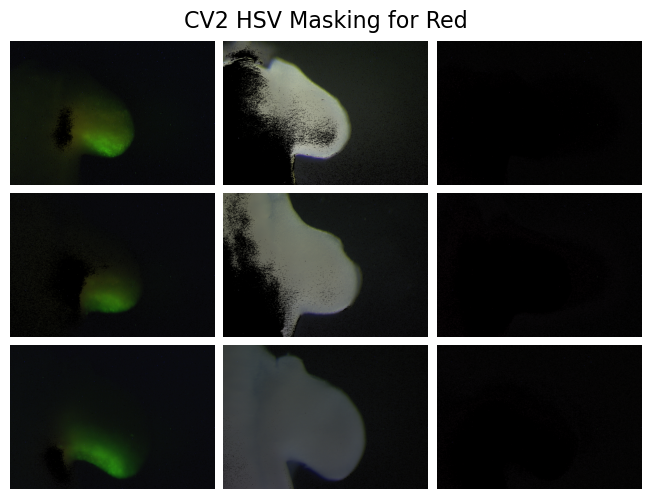

In [9]:
#When we're not dealing with CV2, the channels are Red = 0, Green = 1, and Blue = 2
#For CV2 the channels are Blue = 0, Green = 1, and Red = 2

def cv2_HSV_Masking_for_Red(elist):
    rows = len(elist)
    axes = []
    width, height = plt.rcParams.get('figure.figsize')
    fig = plt.figure(constrained_layout=True, figsize=(width, len(elist)*1.5))
    fig.suptitle('CV2 HSV Masking for Red', fontsize=16)
    for i, x in enumerate(elist):
        img = cv2.imread(x)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV) 
        # define range of red hue in HSV from above
        lower = np.array([30, 0, 0]) #S and V values don't seem to make a difference below about 50
        upper = np.array([170, 255, 255]) #Max hue in HSV is 360
        # Threshold the HSV image to get only red hues
        mask = cv2.inRange(img_hsv, lower, upper) #currently masking for only red
        # Bitwise-AND mask and original image
        res = cv2.bitwise_and(img_rgb, img_rgb, mask=mask)
        # cv2.imshow('img_rgb', img_rgb)
        # cv2.imshow('mask', mask)
        # cv2.imshow('res', res)
        axes.append(fig.add_subplot(rows, 3, i+1))
        plt.axis('off')
        plt.imshow(res, aspect='auto')


cv2_HSV_Masking_for_Red(embryos)


This approach is problematic since some of the red bleed-through is being registered as orange or yellow, and any pixel the has red hue gets masked, and any green light along with it. What if instead of selecting red and masking it, we selected green and hide everything else?

In [ ]:
#When we're not dealing with CV2, the channels are Red = 0, Green = 1, and Blue = 2
#For CV2 the channels are Blue = 0, Green = 1, and Red = 2

green = np.uint8([[[0, 255, 0]]])
hsv_green = cv2.cvtColor(green, cv2.COLOR_BGR2HSV)
print(hsv_green)

[[[ 60 255 255]]]


Now take [H-10, 100,100] and [H+10, 255, 255] as lower bound and upper bounds respectively. -those values didn't work out

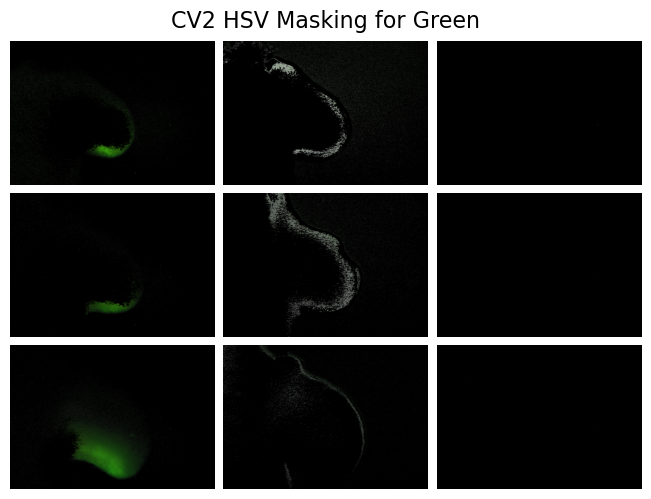

In [10]:
#When we're not dealing with CV2, the channels are Red = 0, Green = 1, and Blue = 2
#For CV2 the channels are Blue = 0, Green = 1, and Red = 2

def cv2_HSV_Masking_for_Green(elist):
    rows = len(elist)
    axes = []
    width, height = plt.rcParams.get('figure.figsize')
    fig = plt.figure(constrained_layout=True, figsize=(width, len(elist)*1.5))
    fig.suptitle('CV2 HSV Masking for Green', fontsize=16)
    for i, x in enumerate(elist):
        img = cv2.imread(x)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)  # Convert BGR to HSV, can also do HSL, LAB, YCrCb and more...
        # define range of green hue in HSV from above
        # S and V values don't seem to make a difference below about 50
        lower = np.array([50, 0, 0])
        upper = np.array([70, 255, 255])
        # Threshold the HSV image to get only green hues
        mask = cv2.inRange(img_hsv, lower, upper)
        # Bitwise-AND mask and original image
        res = cv2.bitwise_and(img_rgb, img_rgb, mask=mask)
        # cv2.imshow('img_rgb', img_rgb)
        # cv2.imshow('mask', mask)
        # cv2.imshow('res', res)
        axes.append(fig.add_subplot(rows, 3, i+1))
        plt.axis('off')
        plt.imshow(res, aspect='auto')


cv2_HSV_Masking_for_Green(embryos)


The Hue definition for 'Green' is too narrow and eliminates some fo the true green signal.

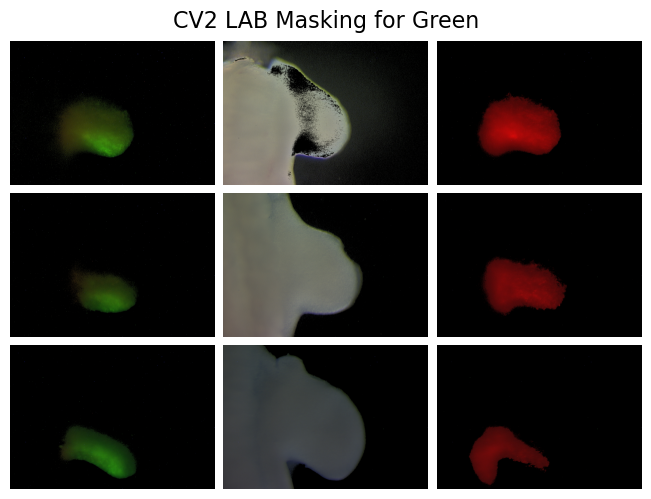

In [11]:
#When we're not dealing with CV2, the channels are Red = 0, Green = 1, and Blue = 2
#For CV2 the channels are Blue = 0, Green = 1, and Red = 2

def cv2_LAB_Masking_for_Green(elist):
    rows = len(elist)
    axes = []
    width, height = plt.rcParams.get('figure.figsize')
    fig = plt.figure(constrained_layout=True, figsize=(width, len(elist)*1.5))
    fig.suptitle('CV2 LAB Masking for Green', fontsize=16)
    for i, x in enumerate(elist):
        img = cv2.imread(x)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)  # Convert BGR to HSV, can also do HSL, LAB, YCrCb and more...
        # define range of green hue in HSV from above
        # S and V values don't seem to make a difference below about 50
        lower = np.array([30, 0, 0])
        upper = np.array([170, 255, 255])
        # Threshold the HSV image to get only green hues
        mask = cv2.inRange(img_hsv, lower, upper)
        # Bitwise-AND mask and original image
        res = cv2.bitwise_and(img_rgb, img_rgb, mask=mask)
        # cv2.imshow('img_rgb', img_rgb)
        # cv2.imshow('mask', mask)
        # cv2.imshow('res', res)
        axes.append(fig.add_subplot(rows, 3, i+1))
        plt.axis('off')
        plt.imshow(res, aspect='auto')


cv2_LAB_Masking_for_Green(embryos)


Ok, what if we just deal with the RGB??

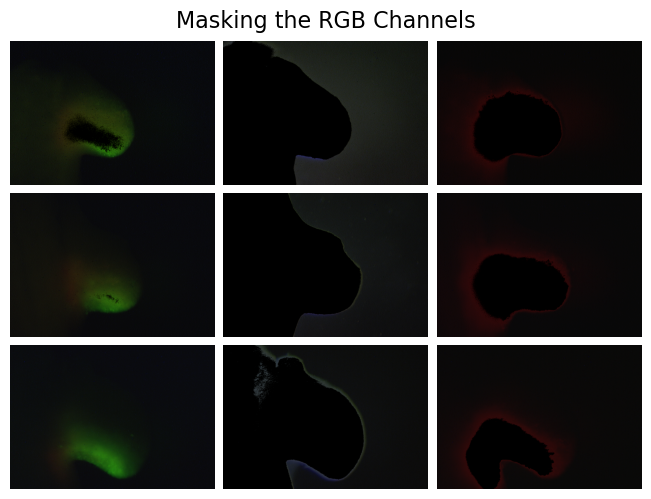

In [12]:
#When we're not dealing with CV2, the channels are Red = 0, Green = 1, and Blue = 2
#For CV2 the channels are Blue = 0, Green = 1, and Red = 2

def cv2_RGB_Masking(elist):
    rows = len(elist)
    axes = []
    width, height = plt.rcParams.get('figure.figsize')
    fig = plt.figure(constrained_layout=True, figsize=(width, len(elist)*1.5))
    fig.suptitle('Masking the RGB Channels', fontsize=16)
    for i, x in enumerate(elist):
        img = cv2.imread(x)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        # define range of red hue 
        lower = np.array([0, 0, 0])
        upper = np.array([50, 255, 255]) #Any Red outside this range gets removed
        # Threshold the HSV image to get only green hues
        mask = cv2.inRange(img_rgb, lower, upper)
        # Bitwise-AND mask and original image
        res = cv2.bitwise_and(img_rgb, img_rgb, mask=mask)
        # cv2.imshow('img_rgb', img_rgb)
        # cv2.imshow('mask', mask)
        # cv2.imshow('res', res)
        axes.append(fig.add_subplot(rows, 3, i+1))
        plt.axis('off')
        plt.imshow(res, aspect='auto')


cv2_RGB_Masking(embryos)


We run into a similar problem here where any pixel that contains red within the given range, gets masked and we lose any green data from that pixel.

### RGB Decomposition

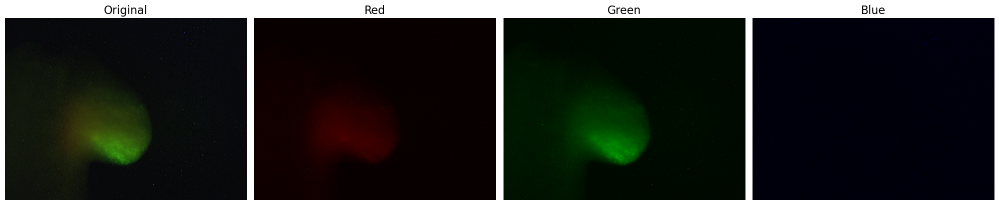

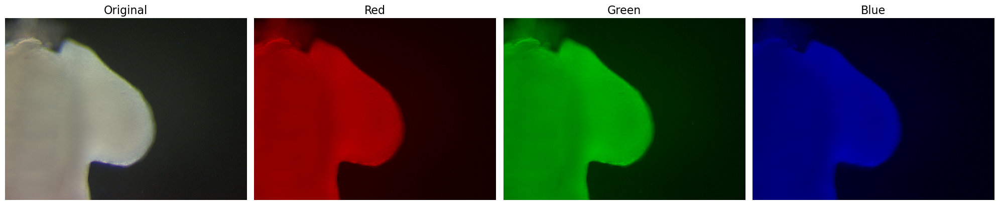

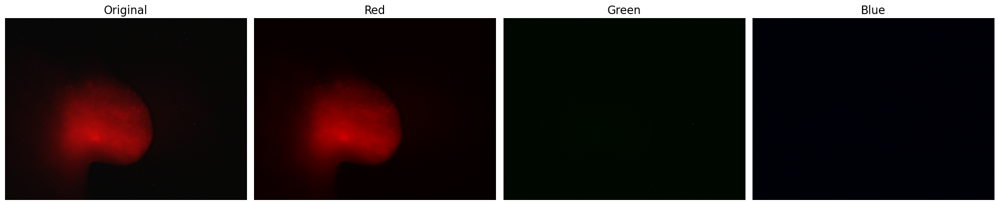

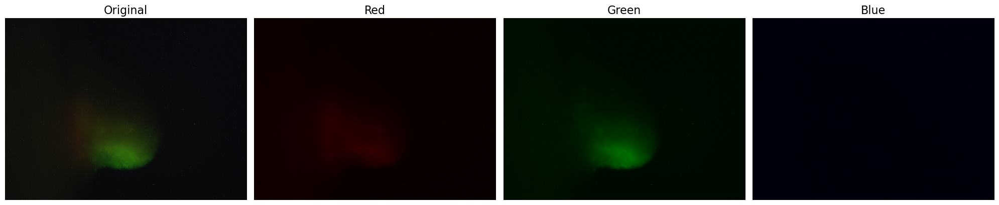

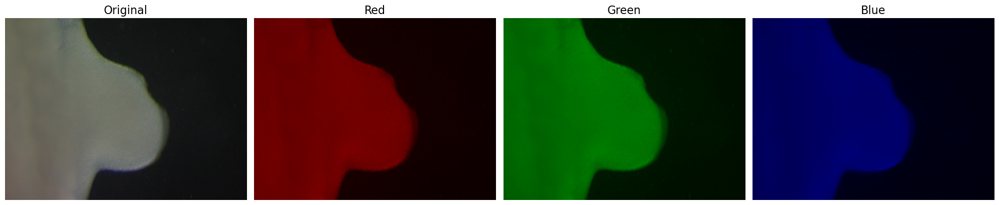

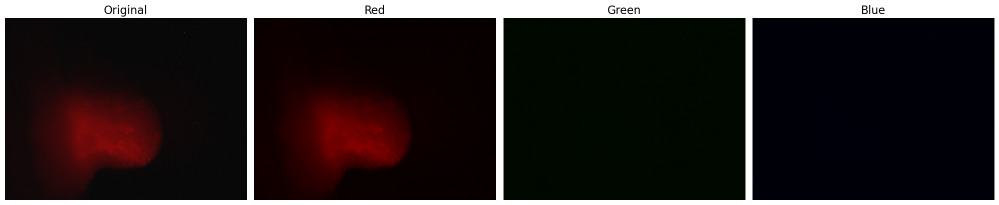

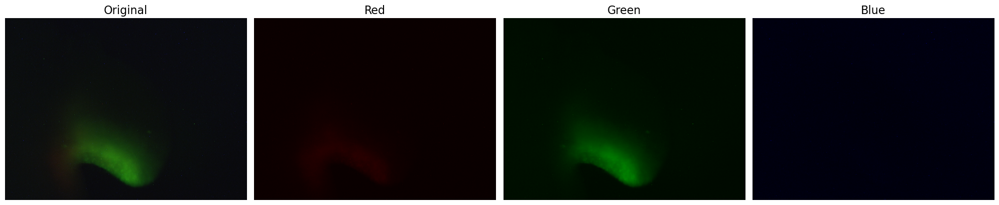

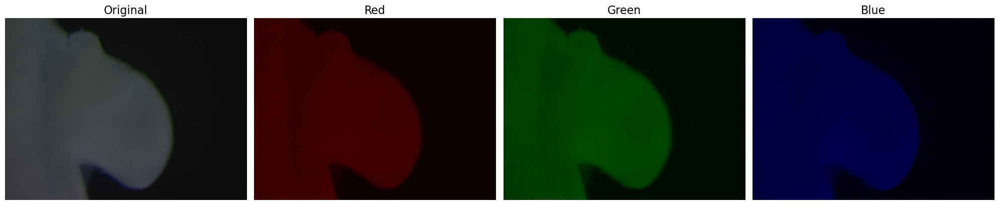

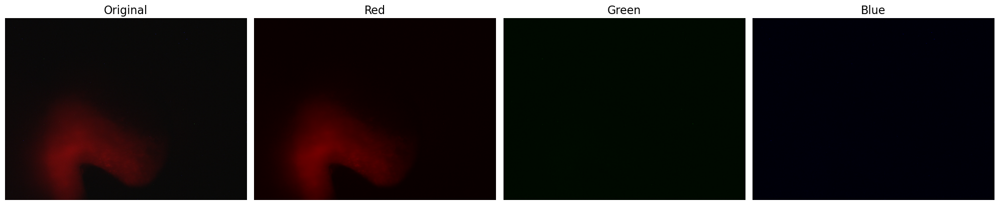

In [13]:
#When we're not dealing with CV2, the channels are Red = 0, Green = 1, and Blue = 2
#For CV2 the channels are Blue = 0, Green = 1, and Red = 2

def rgb_decompose(img_rgb):
    null = np.zeros_like(img_rgb[:, :, 0])
    img_r = np.stack((img_rgb[:, :, 0], null, null), axis=-1)
    img_g = np.stack((null, img_rgb[:, :, 1], null), axis=-1)
    img_b = np.stack((null, null, img_rgb[:, :, 2]), axis=-1)
    # img_gb = np.stack((null, img_rgb[:, :, 1], img_rgb[:, :, 2]), axis=-1)
    return img_r, img_g, img_b



for x in embryos:
    img_rgb = io.imread(x)
    img_r, img_g, img_b = rgb_decompose(img_rgb) # Create an RGB image for each of the channels
    
    titles = ['Original', 'Red', 'Green', 'Blue']
    images = [img_rgb, img_r, img_g, img_b]

    fig, axes = plt.subplots(1, len(images), figsize=(20, 100), sharex=True, sharey=True)
    # fig.suptitle('Color Spaces', fontsize=16)
    ax = axes.ravel()
    for i, img in enumerate(images):
        ax[i].imshow(img)
        ax[i].set_title(titles[i], fontsize=16)
        ax[i].axis('off')
    fig.tight_layout()


Conclusion: RGB decomposition allows us, for the most part, to separate light recorded in the red and green channels. In future steps we will run a comparative analysis to demonstrate the effect of using an RGB vs. a G-only GFP image.

## Step 5: Convert to Grayscale
>Converting to grayscale consolidates the RGB pixel intensities, allowing for quantification.

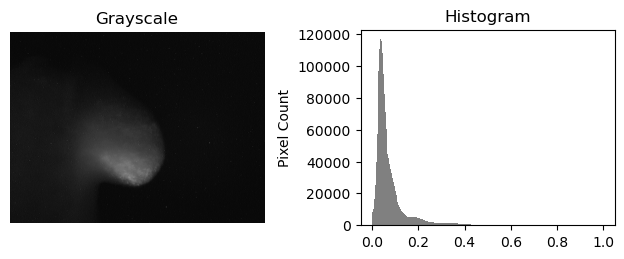

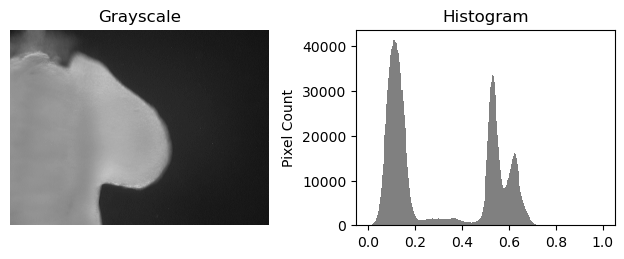

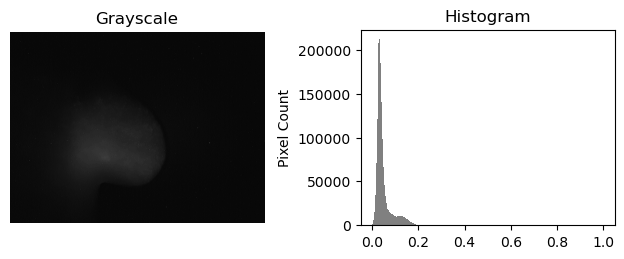

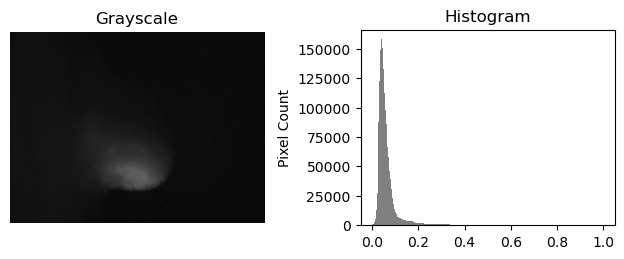

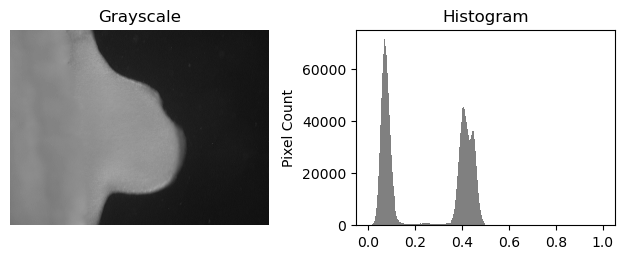

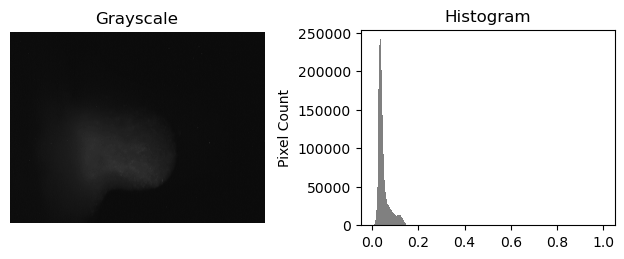

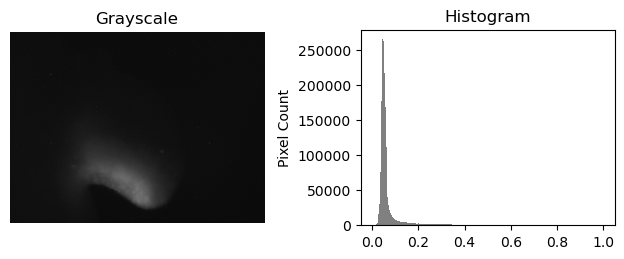

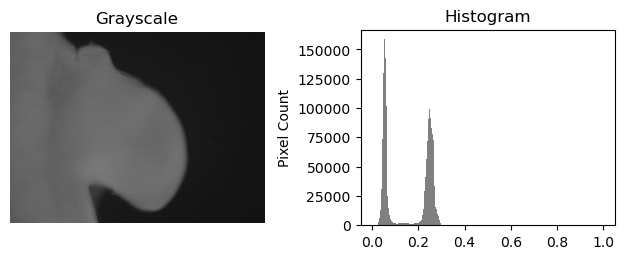

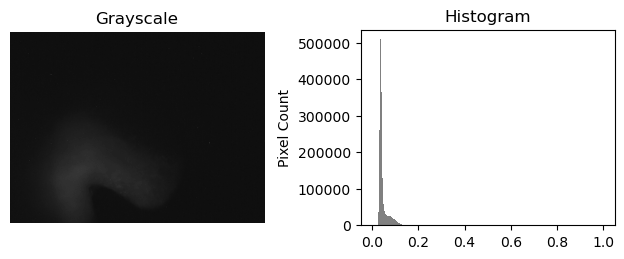

In [14]:

def convert_to_gray(elist):
    for x in elist:
        image = io.imread(x)
        gray_image = rgb2gray(image)
        fig = plt.figure()
        #fig, axes = plt.subplots(1, 2, figsize=(20, 100), sharex=True, sharey=True)
        # fig.suptitle('Color Spaces', fontsize=16)
        # ax = axes.ravel()
        fig.add_subplot(221)
        plt.imshow(gray_image, cmap='gray')
        plt.title('Grayscale', fontsize=12)
        plt.axis('off')

        fig.add_subplot(222)
        # Plot the histogram of the gray image. The frequency of the gray histogram decreases ~ 1/3 of the color histogram
        # 0-1 because this method rescales.
        plt.hist(gray_image.ravel(), bins=256, range=[0, 1], color='gray')
        plt.title('Histogram', fontsize=12)
        plt.ylabel('Pixel Count')
        fig.tight_layout()

convert_to_gray(embryos)


## Step 6: Noise Removal
>Image blurring is a low-pass filter technique to reduce noise, but it can also affect edge detection. Choose one method and continue. 

[CV2 Blurring](https://docs.opencv.org/3.1.0/d4/d13/tutorial_py_filtering.html)

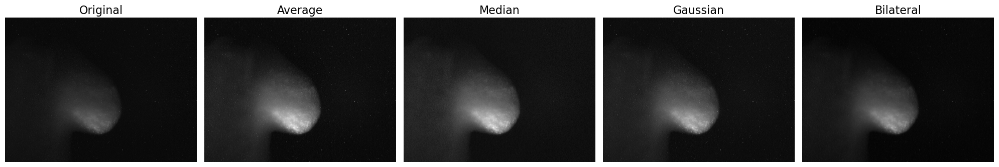

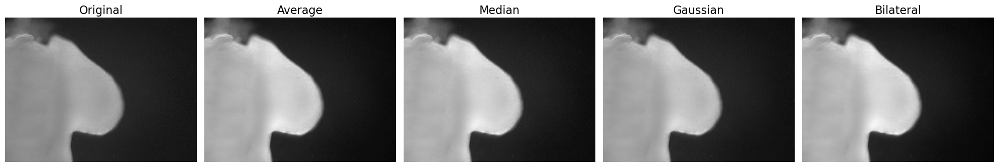

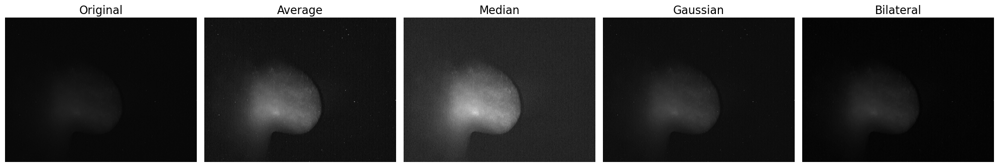

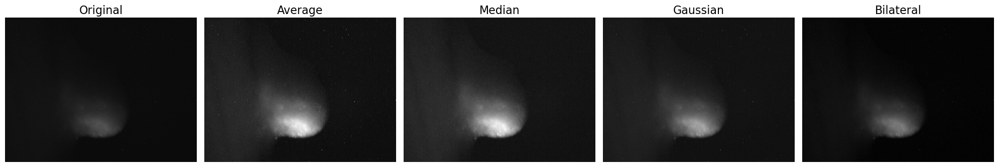

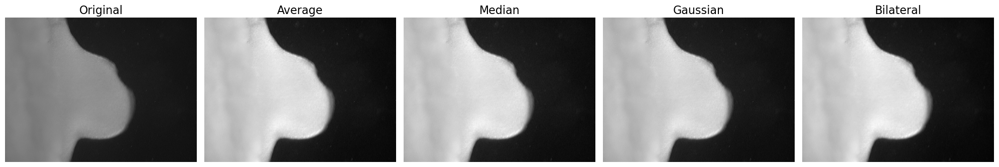

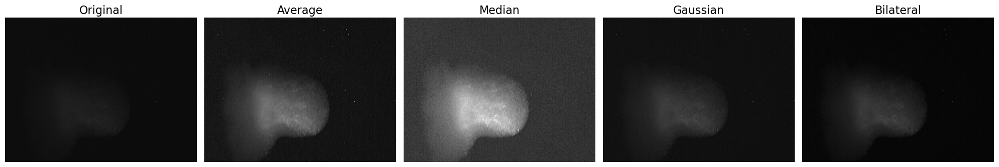

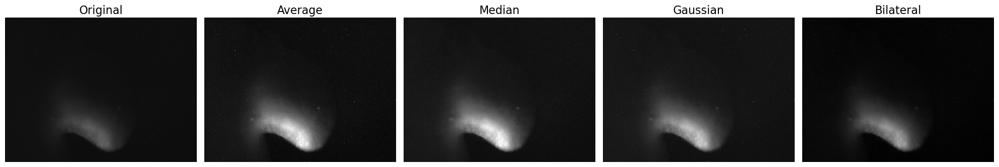

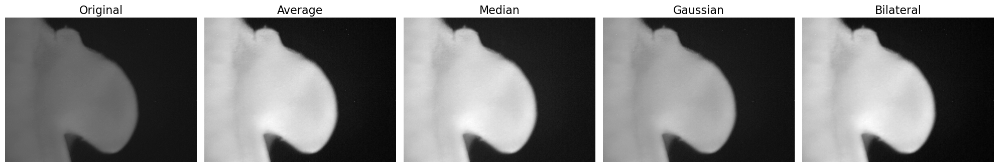

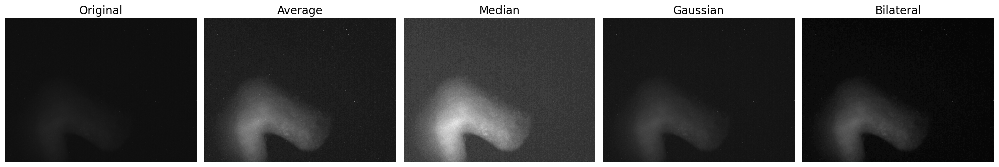

In [15]:
def blur_test(elist):
    for x in elist:
        image = io.imread(x)
        image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        # Averaging Blur: uses a boxfilter with a 5x5 kernel
        blur = cv2.blur(image_gray, (5, 5))
        # Median Blur: good for salt and pepper noise
        median = cv2.medianBlur(image_gray, 5)
        # Gaussian Blur: set to a 5x5 kernel, can also specify stdev, good for gaussian noise
        gaussian = cv2.GaussianBlur(image_gray, (5, 5), 0)
        # Bilateral Filtering: a Gaussian blur filter that preserves edges
        bilateral = cv2.bilateralFilter(image_gray, 9, 75, 75)
    
        titles = ['Original', 'Average', 'Median', 'Gaussian', 'Bilateral']
        images = [image_gray, blur, median, gaussian, bilateral]
    
        fig, axes = plt.subplots(1, len(images), figsize=(20, 100), sharex=True, sharey=True)
        #fig.suptitle('CV2 Blurring Methods', fontsize=16)
        ax = axes.ravel()
        for i, img in enumerate(images):
            ax[i].imshow(img, cmap='gray')
            ax[i].set_title(titles[i], fontsize=16)
            ax[i].axis('off')
        fig.tight_layout()


blur_test(embryos)


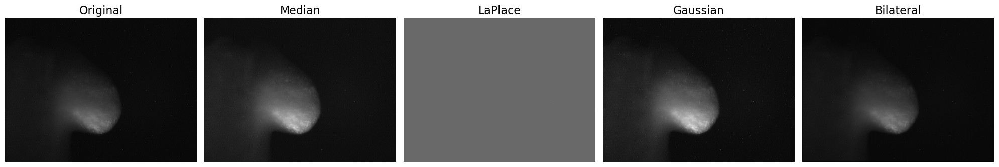

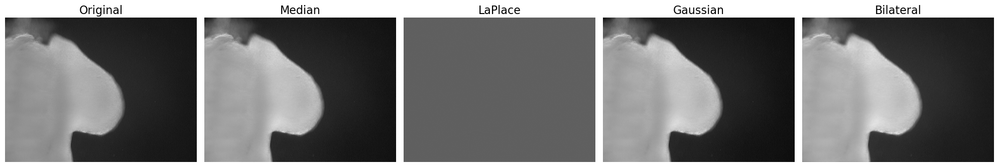

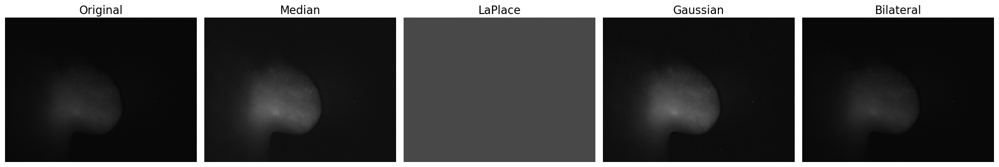

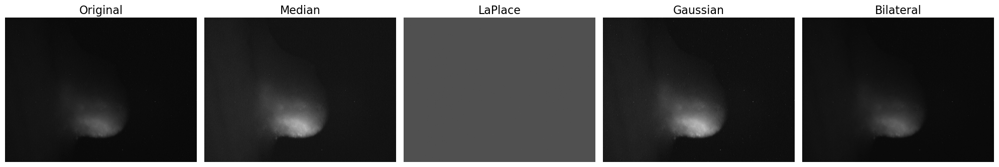

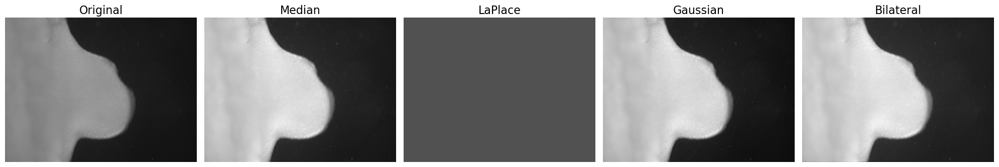

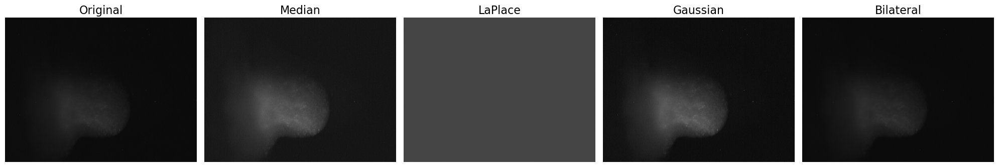

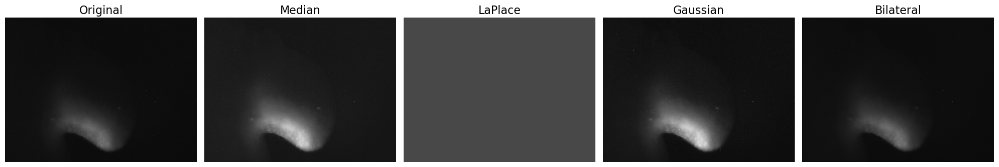

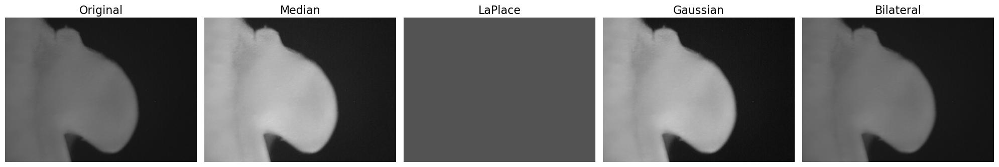

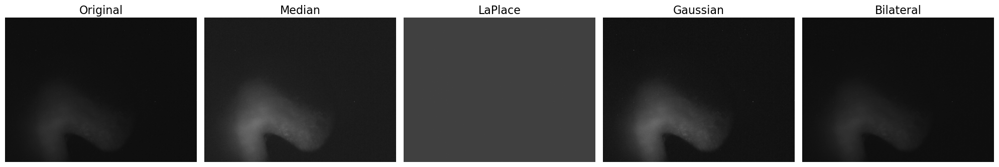

In [17]:

def blur_test(image):
    image = rgb2gray(image)
    # Blurring options
    blur1 = filters.median(image)
    blur2 = filters.laplace(image)
    blur3 = filters.gaussian(image)
    blur4 = restoration.denoise_bilateral(image)

    titles = ['Original', 'Median', 'LaPlace', 'Gaussian', 'Bilateral']
    images = [image, blur1, blur2, blur3, blur4]
    
    fig, axes = plt.subplots(1, len(images), figsize=(20, 100), sharex=True, sharey=True)
    # fig.suptitle('Skimage Blurring Methods', fontsize=16)
    ax = axes.ravel()
    for i, img in enumerate(images):
        ax[i].imshow(img, cmap='gray')
        ax[i].set_title(titles[i], fontsize=16)
        ax[i].axis('off')
    fig.tight_layout()


iterator(blur_test, embryos)


## Step 7: Edge Detection
>Contours and thresholding allow you to find edges of objects within the image, they can be used to define regions of interest (ROIs) and to make masks. Several methods are shown, select one or more to use in the next step.

### [Matplotlib Contours](https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.contour.html)

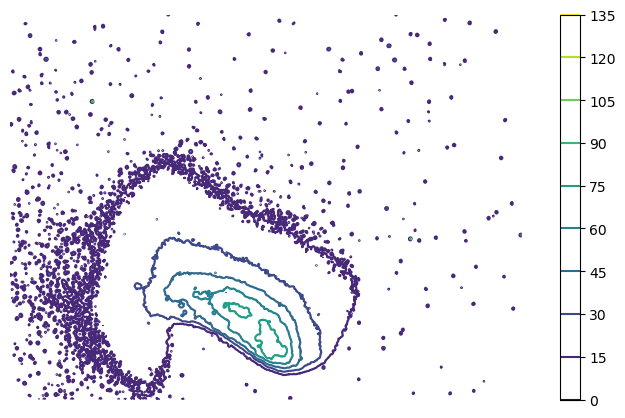

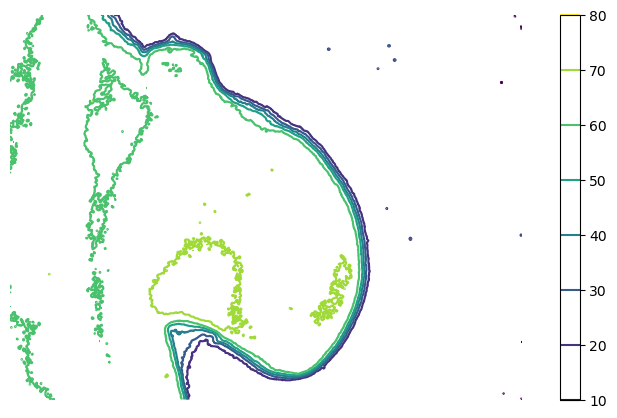

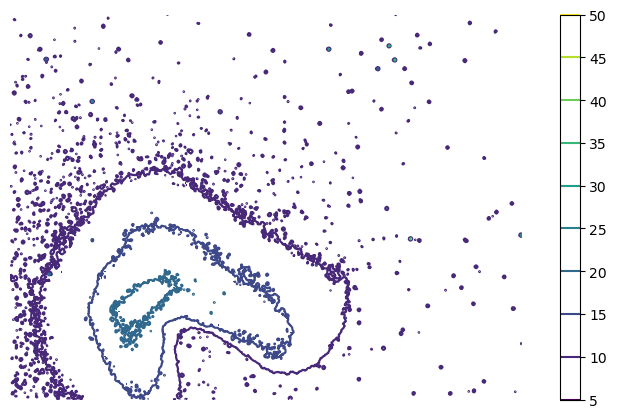

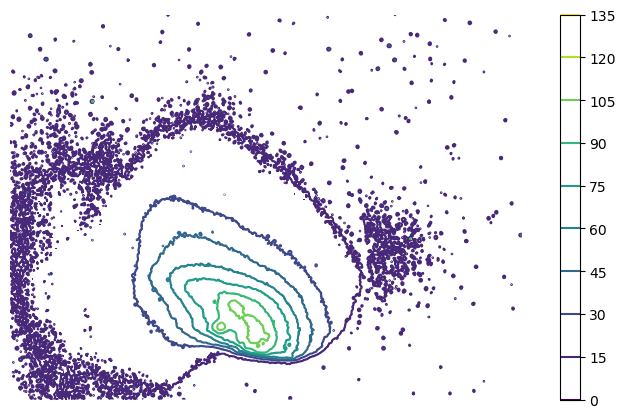

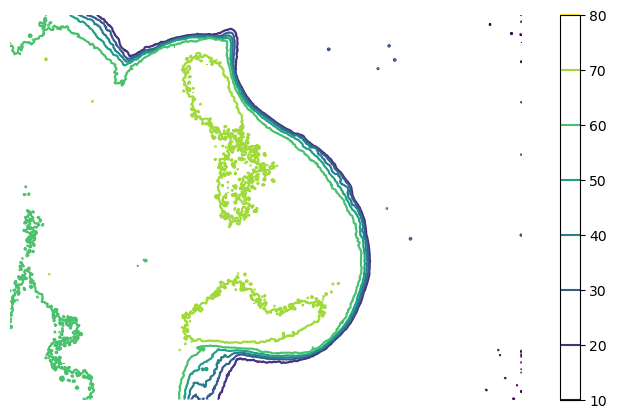

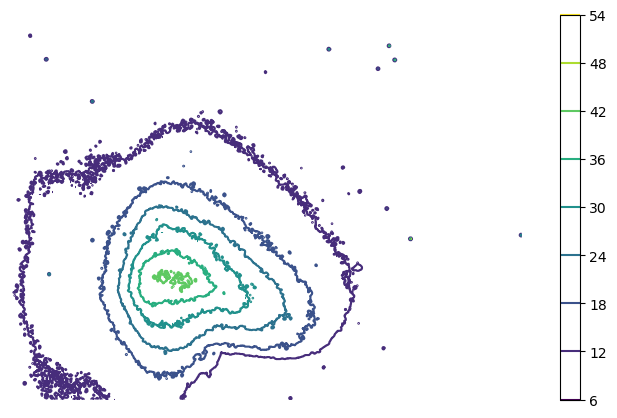

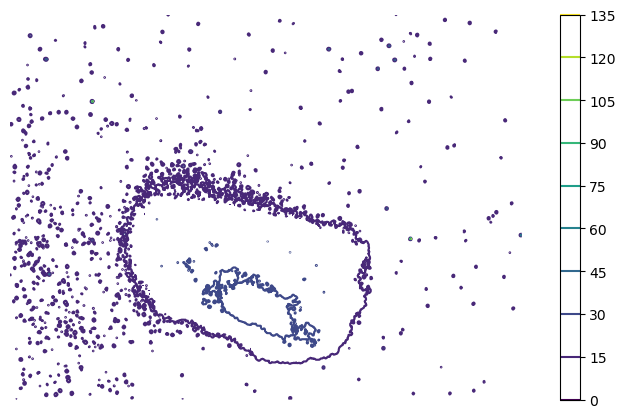

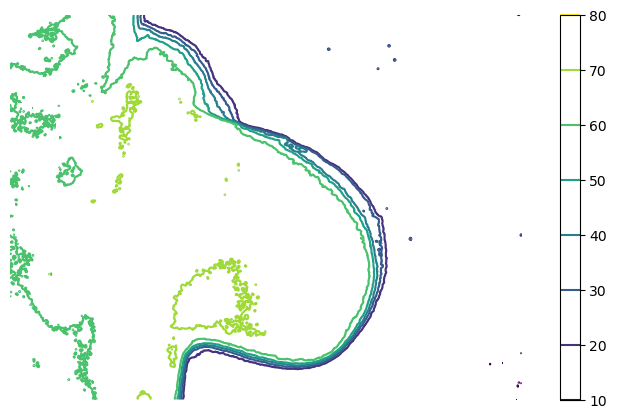

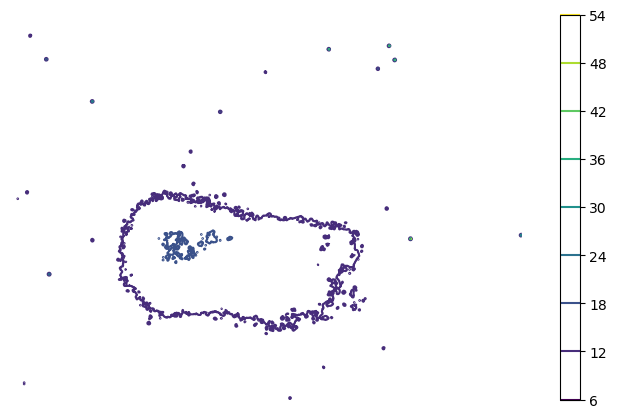

In [10]:

def matplotlib_ctrs(image):
    # For some reason this won't work with the Skimage rgb2gray method
    image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # Bilateral Filtering: a Gaussian blur filter that preserves edges
    image_blur = cv2.bilateralFilter(image_gray, 9, 75, 75)
    fig, ax = plt.subplots(figsize=(10, 5))
    ax.set_aspect('equal')
    ax.axis('off')
    cp = ax.contour(image_blur, origin='image')
    fig.colorbar(cp, ax=ax)
    plt.show()
    return cp


iterator(matplotlib_ctrs, embryos)


### [CV2 Contours](https://docs.opencv.org/3.1.0/d4/d73/tutorial_py_contours_begin.html)

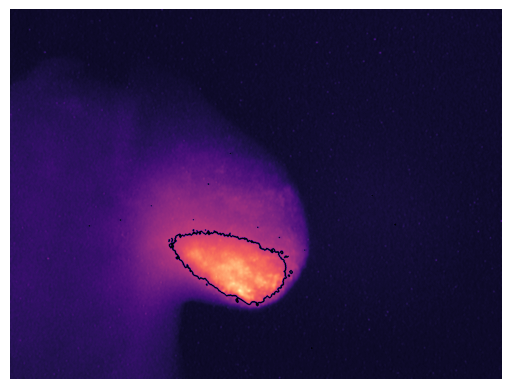

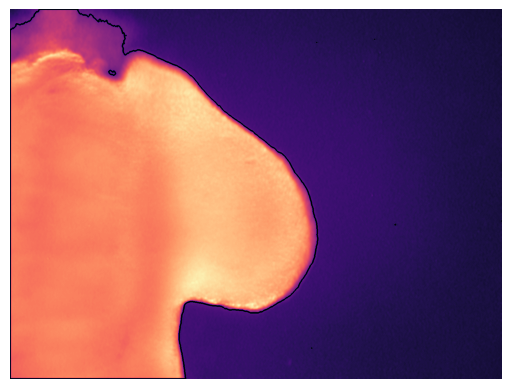

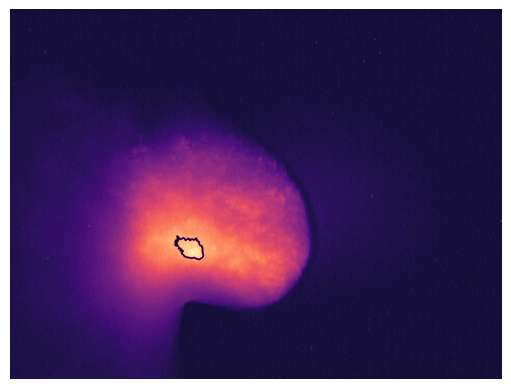

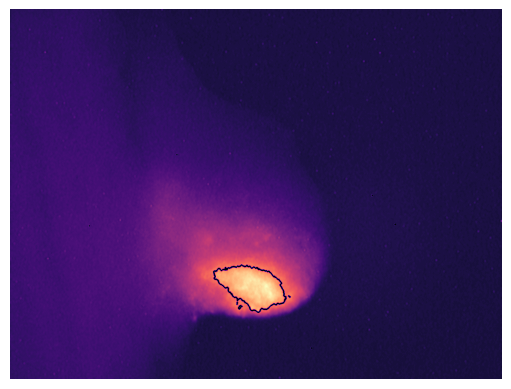

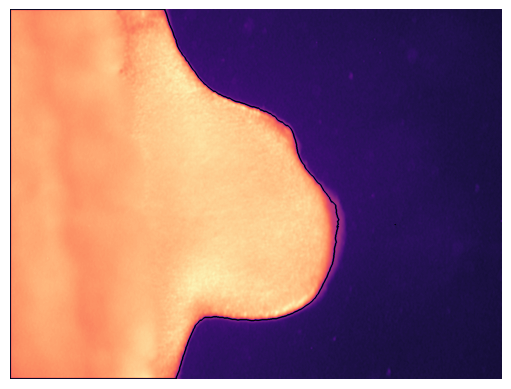

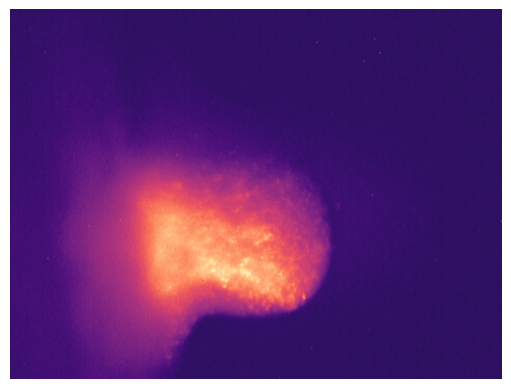

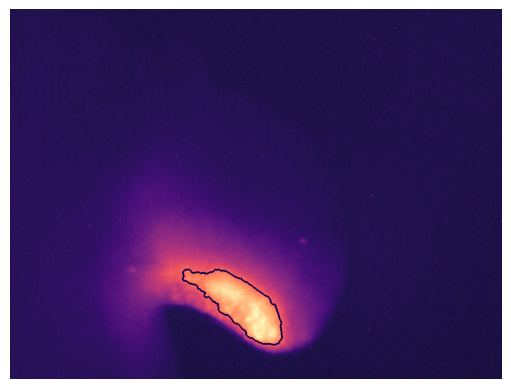

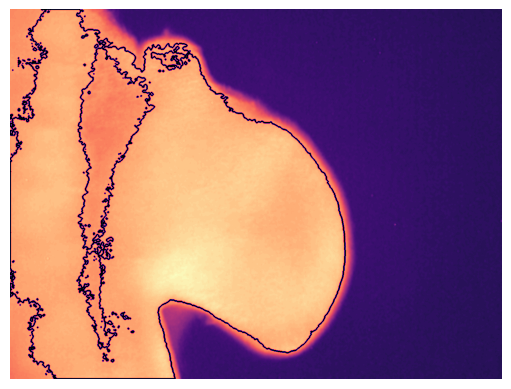

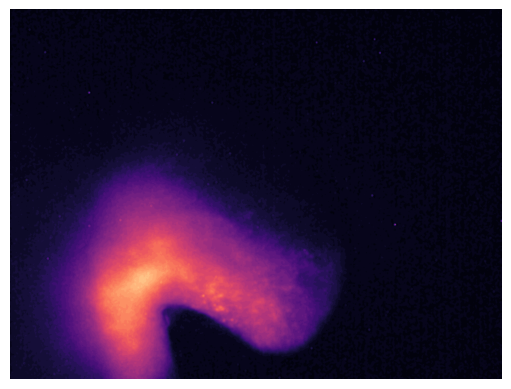

In [9]:
# Set threshold for the contour detection
def cv2_ctrs(elist):
    label = ['gfp','light', 'rfp']
    i=0 
    for x in elist:
        image = io.imread(x)
        image_gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
        image_blur = cv2.bilateralFilter(image_gray, 9, 75, 75)
        # This is where you can adjust the thresholding
        ret, thresh = cv2.threshold(image_blur, 60, 120, 0)
        contours, hierarchy = cv2.findContours(
            thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        image_ctr = cv2.drawContours(image_blur, contours, -1, (0, 255, 0), 3)
        #plt.figure(figsize=([10, 5]))
        plt.imshow(image_ctr, cmap='magma'), plt.axis('off')
        #plt.savefig(f'{label[i]}_thresh.svg',dpi=500)
        # i +=1
        plt.show()
        # cnt = contours[2] #Different approach that allows to to specify the number of contours
        #image_ctr = cv2.drawContours(image_blur, [cnt], -1, (0,255,0), 3)
        # return image_ctr

cv2_ctrs(embryos)

### [CV2 Thresholding](https://docs.opencv.org/4.x/d7/d4d/tutorial_py_thresholding.html)

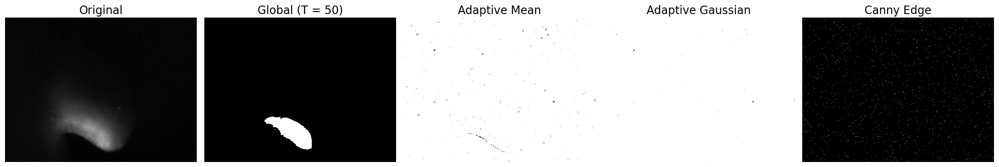

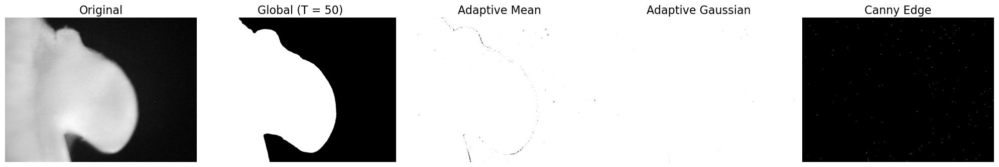

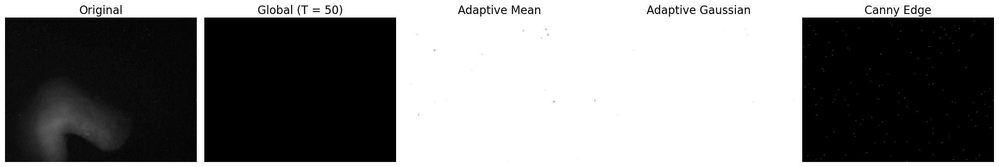

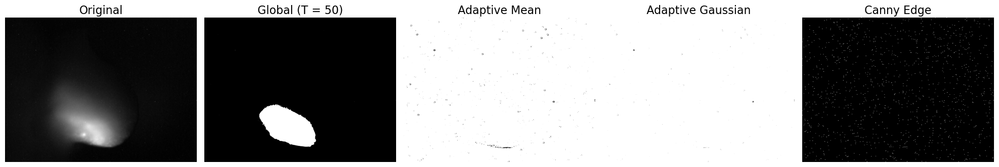

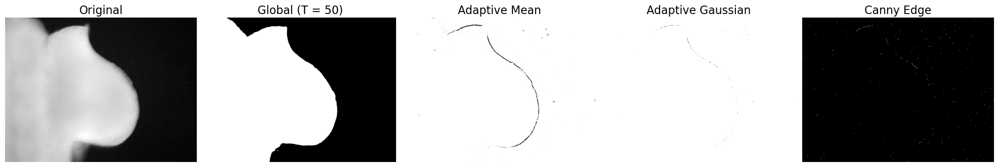

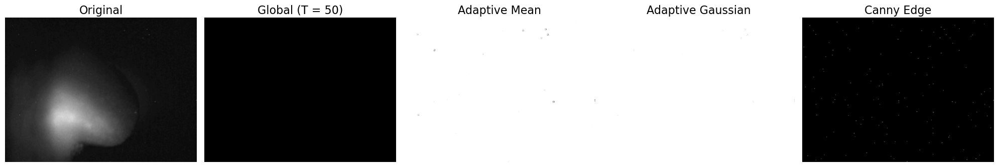

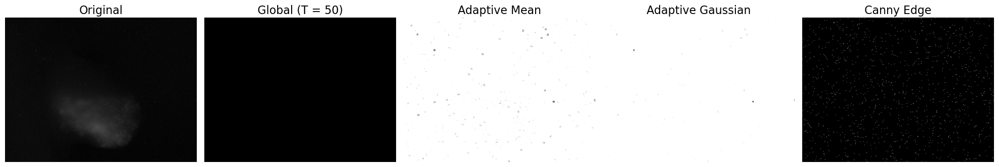

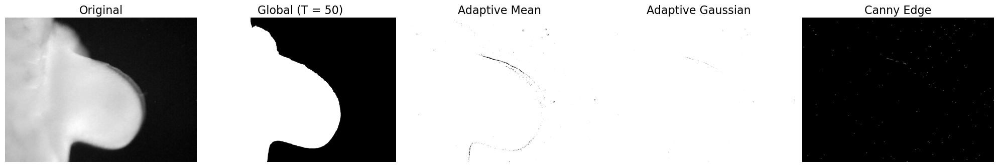

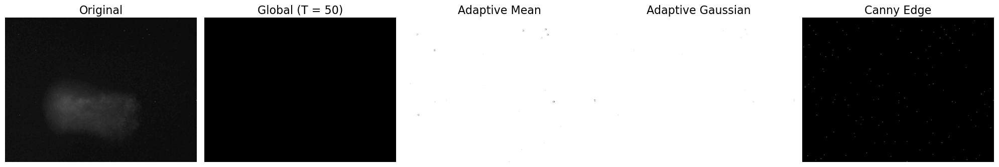

In [19]:

def cv2_thresholds(image):  # Image must be grayscale
    image_gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    image_blur = cv2.bilateralFilter(image_gray, 9, 75, 75)
    ret, global_t = cv2.threshold(image_blur, 50, 120, cv2.THRESH_BINARY)
    adaptive_mean = cv2.adaptiveThreshold(image_blur, 120, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 2)
    adaptive_gaussian = cv2.adaptiveThreshold(image_blur, 120, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)
    canny_edge = cv2.Canny(image, 60, 110)  # set the thresholding here
    
    titles = ['Original', 'Global (T = 50)', 'Adaptive Mean', 'Adaptive Gaussian', 'Canny Edge']
    images = [image_blur, global_t, adaptive_mean, adaptive_gaussian, canny_edge]
    
    fig, axes = plt.subplots(1, len(images), figsize=(20, 100), sharex=True, sharey=True)
    # fig.suptitle('CV2 Thresholding Methods', fontsize=16)
    ax = axes.ravel()
    for i, img in enumerate(images):
        ax[i].imshow(img, cmap='gray')
        ax[i].set_title(titles[i], fontsize=16)
        ax[i].axis('off')
    fig.tight_layout()

iterator(cv2_thresholds, embryos)


### [Skimage Thresholding](https://datacarpentry.org/image-processing/07-thresholding/index.html)

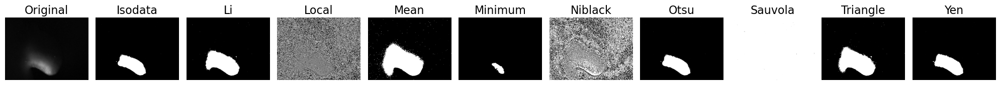

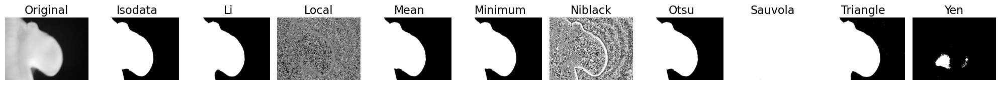

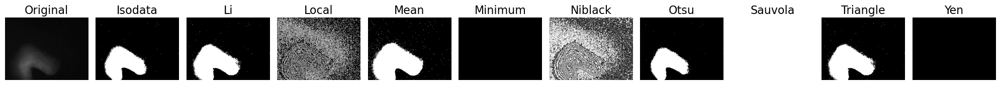

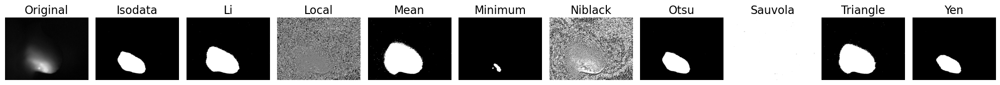

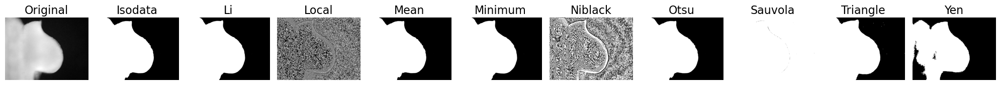

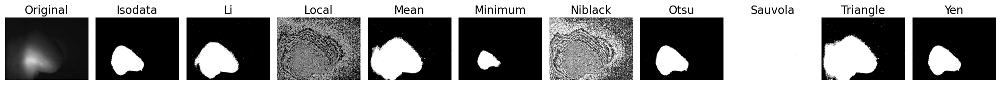

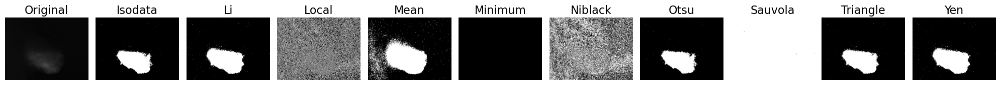

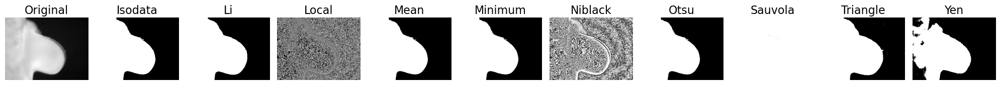

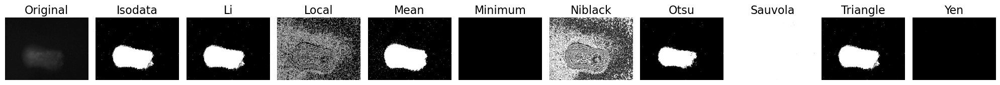

In [20]:

def compare_thresholds(image):
    #image_gray = rgb2gray(image)
    # image_blur = image_gray #filters.gaussian(image_gray)
    #try_all = filters.try_all_threshold(image_blur, figsize=(20,10), verbose=False)
    image_gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    image_blur = cv2.bilateralFilter(image_gray, 9, 75, 75)
    isodata_t = filters.threshold_isodata(image_blur)
    isodata_image = image_blur > isodata_t
    li_t = filters.threshold_li(image_blur)
    li_image = image_blur > li_t
    local_t = filters.threshold_local(image_blur, block_size=5)
    local_image = image_blur > local_t
    mean_t = filters.threshold_mean(image_blur)
    mean_image = image_blur > mean_t
    minimum_t = filters.threshold_minimum(image_blur)
    minimum_image = image_blur > minimum_t
    niblack_t = filters.threshold_niblack(image_blur)
    niblack_image = image_blur > niblack_t
    otsu_t = filters.threshold_otsu(image_blur)
    otsu_image = image_blur > otsu_t
    sauvola_t = filters.threshold_sauvola(image_blur)
    sauvola_image = image_blur > sauvola_t
    triangle_t = filters.threshold_triangle(image_blur)
    triangle_image = image_blur > triangle_t
    yen_t = filters.threshold_yen(image_blur)
    yen_image = image_blur > yen_t
    
    titles = ['Original', 'Isodata', 'Li', 'Local', 'Mean', 'Minimum', 'Niblack', 'Otsu', 'Sauvola', 'Triangle', 'Yen']
    images = [image_blur, isodata_image, li_image, local_image, mean_image, minimum_image, niblack_image, otsu_image, sauvola_image, triangle_image, yen_image]

    fig, axes = plt.subplots(1, len(images), figsize=(20, 100), sharex=True, sharey=True)
    ax = axes.ravel()
    for i, img in enumerate(images):
        ax[i].imshow(img, cmap='gray')
        ax[i].set_title(titles[i], fontsize=16)
        ax[i].axis('off')
    fig.tight_layout()


iterator(compare_thresholds, embryos)


Conclusions: 
* For light images, most of the methods seem equivalent, though the Li, Minimum, and Triangle can pick up more noise and Yen often doesn't work at all. For light images I will use the Otsu Method because it does the job while avoiding noise. The Isodata and Mean methods may be good alternatives.
* For fluorescent images that are fairly bright, the Minimum method doesn't pick up anything and the Yen methods only works half of the time. The mean method usually has high background, the Isodata, Li, and Otsu methods seem to do a pretty good job, but I think the Otsu method has the lowest background. The Triangle method seems to perform similarly to the Otsu method, but in some cases it is too stringent and does not pick up a large are of weak fluorescence, if there are a few, brighter foci. For fluorescent images, I may need to test out the Otsu and Triangle methods on more images, or consider alternative filters.



## Step 8: ROIs and Masking
>Determine ROIs with a widget, and masks using the previously selected threshold(s).

### Draw an ROI by hand to separate the 'Limb' from 'non-Limb' tissue using [RoiPoly](https://github.com/jdoepfert/roipoly.py)

In [17]:
image = io.imread('2023-01-17_E24_cZRS_WT_RLD_63x_Light_05s.jpg')
image_gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
image_blur = cv2.bilateralFilter(image_gray, 9, 75, 75)
post_blur = image_blur
zpa_blur = image_blur
bg_blur = image_blur

%matplotlib auto
plt.imshow(image_blur, cmap='gray')
plt.axis('off') 
roi = RoiPoly(color='r')  #Draw new ROI in red, left click to add new point, right click to close ROI


Using matplotlib backend: QtAgg


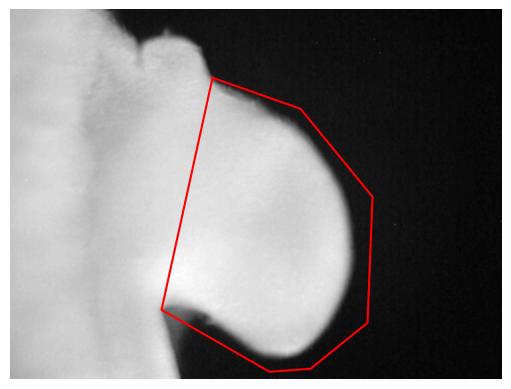

In [34]:
%matplotlib inline
plt.imshow(image_blur, cmap='gray'), plt.axis('off')
# Displays the ROI red outline that we drew on top of the original image
roi.display_roi()
# for r in [roi1, roi2, roi3]: #For multiple ROIs
#     r.display_roi()
# roi.display_mean(image)  # For gray image
# mask = roi.display_mean(image[:, :, 0]) #For RGB image
#plt.savefig('light_roi.svg', dpi=500)


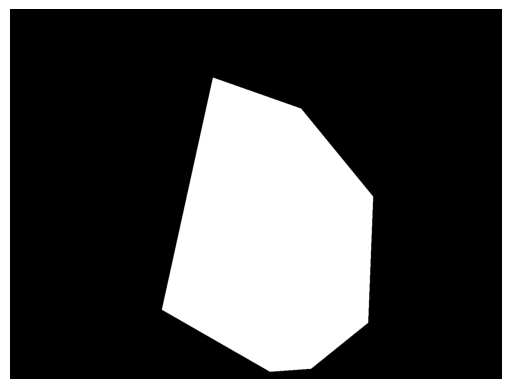

In [35]:
roi_mask = roi.get_mask(image_blur)  # For grayscale
# mask = roi.get_mask(image[:,:, 0]) #For RGB
plt.imshow(roi_mask, cmap='gray'), plt.axis('off')  # show the roi mask
#plt.savefig('roi_mask.svg', dpi=500)

### Defining the limb from background using thresholding
Most of the following masking steps are adapted from lessons/episodes at [Datacarpentry](https://datacarpentry.org/image-processing/)

(<matplotlib.image.AxesImage at 0x19f644c7310>, (-0.5, 1519.5, 1143.5, -0.5))

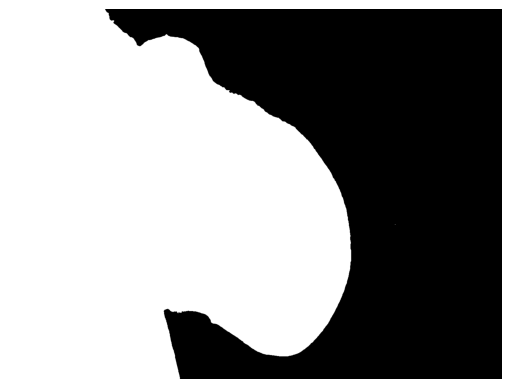

In [36]:
# Define the other boundaries of the limb using your selected thresholding method
t = filters.threshold_otsu(image_blur)
light_thresh_mask = image_blur > t
plt.imshow(light_thresh_mask, cmap='gray'), plt.axis('off')
#plt.savefig('thresh_mask.svg', dpi=500)


(-0.5, 1519.5, 1143.5, -0.5)

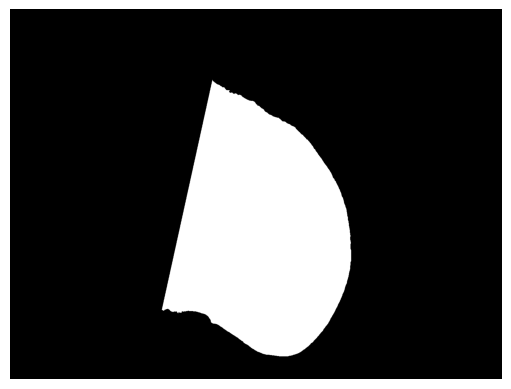

In [37]:
limb_mask = light_thresh_mask * roi_mask # Combining the two masks to define the region of limb
plt.imshow(limb_mask, cmap='gray')
plt.axis('off')
#plt.savefig('limb_mask.svg', dpi=500)


In [38]:
spare = post_blur.copy()

(-0.5, 1519.5, 1143.5, -0.5)

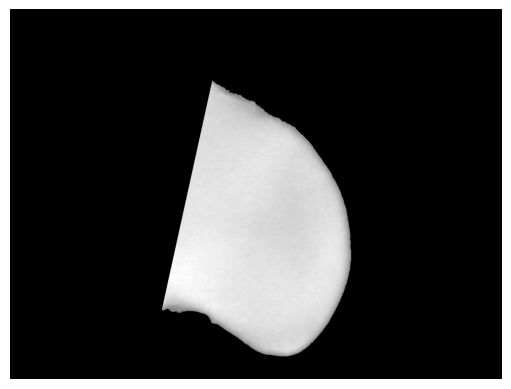

In [39]:
limb_mask = light_thresh_mask * roi_mask  # Combining the two masks to define the region of limb
post_blur[~limb_mask] = 0
plt.imshow(post_blur, cmap='gray')
plt.axis('off')


left: (474, 905)
right: (1053, 779)
top: (622, 233)
bottom: (831, 1073)


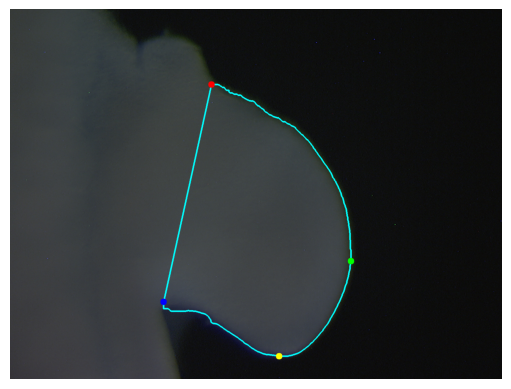

In [43]:
# Find the Extreme points of the limb using contours
def find_extremes(img):
    thresh = cv2.threshold(img, 60, 150, cv2.THRESH_BINARY)[1]
    # erosions and dilations to remove noise
    thresh = cv2.erode(thresh, None, iterations=10)
    thresh = cv2.dilate(thresh, None, iterations=10)
    cnts = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = cnts[0] if len(cnts) == 2 else cnts[1]
    c = max(cnts, key=cv2.contourArea)

    # Obtain outer coordinates
    left = tuple(c[c[:, :, 0].argmin()][0])
    right = tuple(c[c[:, :, 0].argmax()][0])
    top = tuple(c[c[:, :, 1].argmin()][0])
    bottom = tuple(c[c[:, :, 1].argmax()][0])

    # Draw dots onto image
    cv2.drawContours(image, [c], -1, (0, 255, 255), 4)
    cv2.circle(image, left, 10, (0, 0, 255), -1)
    cv2.circle(image, right, 10, (0, 255, 0), -1)
    cv2.circle(image, top, 10, (255, 0, 0), -1)
    cv2.circle(image, bottom, 10, (255, 255, 0), -1)

    print('left: {}'.format(left))
    print('right: {}'.format(right))
    print('top: {}'.format(top))
    print('bottom: {}'.format(bottom))
    plt.imshow(image, cmap='gray')
    plt.axis('off')
    return left, right, top, bottom

image = io.imread('2023-01-17_E24_cZRS_WT_RLD_63x_Light_05s.jpg')
left1, right1, top1, bottom1 = find_extremes(post_blur)

(-0.5, 1519.5, 1143.5, -0.5)

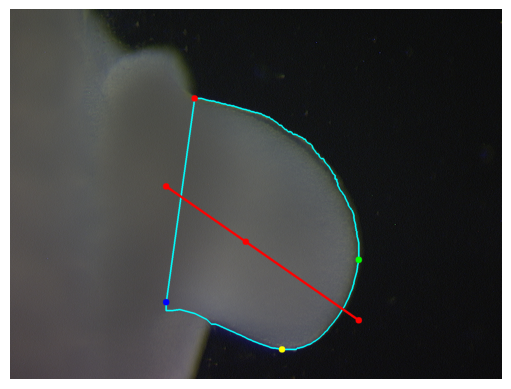

In [90]:
#Subtract 349 pixels/500 microns from the x coordinate
list_right=list(right1) #converts right tuple into a list
list_right[0]-=349 #substract 349 from the x coordinate of the right point
midpoint=tuple(list_right) #convert list of right coordinate back into tuple

def slope_equation(pt1,pt2): # defines the slope of the two points
    list(pt1)
    list(pt2)
    slope=(pt2[1]-pt1[1])/(pt2[0]-pt1[0])
    intercept=pt2[1]-(slope*pt2[0])
    return slope, intercept 

slope1, intercept1 = slope_equation(right1, top1)
slope2, intercept2 = slope_equation(bottom1, left1)
slope_ratio = slope1/slope2
#print('Slope Ratio:', slope_ratio)
#Good Ratios: 0.4, 3.5, 7.9
#Bad ratios: 0.03, 0.005

if slope_ratio > 0.1:
    avg_slope = (slope1+slope2)/2
    avg_intercept = (intercept1+intercept2)/2
    # finds Y coordinate by plugging in x value of our midpoint and seeing what is our corresponding Y value is on the slope equation.
    y = round((avg_slope) * midpoint[0] + (avg_intercept))
    # adjusted coordinate along the averge slope of the limb, different from midpoint because midpoint only is 500 microns in from right, this one is adjusted for slope of limb.
    midpoint_adj = [midpoint[0], y]
    #This is an X,Y coordiante system but X increases left to right and Y increases top to bottom. Thus, the origin is the top left of graph.
    # Finds the slope of the line that is perpendicular to the slope of the limb
    perp_slope = (np.reciprocal(avg_slope))*-1
    # Solves for b in y=mx+b, to find the perpeindicualr line intercept using x,y from the adjusted midpoint
    perp_intercept = round(midpoint_adj[1]+(-perp_slope*midpoint_adj[0]))
    # we take the x coordinate of the 'left' point and plug into our avg slope_intercept equation to get the output of where that value will be
    y_left = round((avg_slope)*left1[0]+(avg_intercept))
    midpoint_left = [left1[0], y_left]
    # takes the x coordinate from 'right' and apply it to the new avg slope equation to get its corresponding y
    y_right = round((avg_slope)*right1[0]+(avg_intercept))
    # takes right coordinate point from midpoint coordinate that is applied to the slope equation
    midpoint_right = [right1[0], y_right]
    # we take the x coordinate of the 'left' point and plug into y=mx=b but for our perpindicualr slope at a point where it intercepts at the midpoint coordinate('B' refers to the new y intercept made for intersecting our perpindicular slope at midpoint coorindate)
    y_left_perp = round((perp_slope)*left1[0]+(perp_intercept))
    midpoint_left_perp = [left1[0], y_left_perp]
    # we take the x value coordinate from 'right' and apply it to our new avg slope equation to get its corresponding y
    y_right_perp = round((perp_slope)*right1[0]+(perp_intercept))
    # takes right coordinate point from our midpoint coordinate that is applied to the slope equation
    midpoint_right_perp = [right1[0], y_right_perp]
else:
    avg_slope = 0 
    avg_intercept = midpoint[1]
    midpoint_adj = midpoint
    midpoint_left = [left1[0], right1[1]]
    midpoint_right = right1
    midpoint_left_perp = [midpoint[0], bottom1[1]]
    midpoint_right_perp = [midpoint[0], top1[1]]
    half = round((bottom1[1]-top1[1])/2)
    half_coord_l = [bottom1[0], bottom1[1]-half]
    half_coord_r = [right1[0], half_coord_l[1]]
    if half_coord_l[1] < midpoint_left[1]:
        midpoint_left = half_coord_l
        midpoint_right = half_coord_r
        midpoint_adj = [midpoint[0], half_coord_l[1]]

cv2.circle(image, midpoint_left, 10, (255, 0, 0), -1)
cv2.circle(image, midpoint_right, 10, (255, 0, 0), -1)
cv2.line(image, midpoint_right, midpoint_left, color=(255, 0, 0),thickness=5)  # draws a line of the average slope

cv2.circle(image, midpoint_adj, 10, (255, 0, 0), -1)
plt.imshow(image)
plt.axis('off')


Posterior Mask

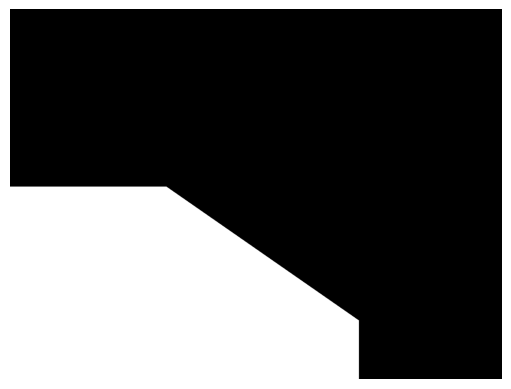

In [56]:
far_left = [0, midpoint_left[1]]
right_bottom = [midpoint_right[0], image.shape[1]]
left_bottom = [0, image.shape[1]]

def polygon_mask(polygon,img):
    poly_path = Path(polygon)
    width = img.shape[0]
    height = img.shape[1]
    y, x = np.mgrid[:width, :height]
    coors = np.hstack((x.reshape(-1, 1), y.reshape(-1, 1))) 
    mask1 = poly_path.contains_points(coors)
    mask2 = mask1.reshape(width, height)
    return mask2

polygon = [far_left, midpoint_left, midpoint_right, right_bottom, left_bottom] #list the polygon vertices in order
post_poly_mask = polygon_mask(polygon, post_blur)
plt.imshow(post_poly_mask, cmap='gray'), plt.axis('off')

(-0.5, 1519.5, 1143.5, -0.5)

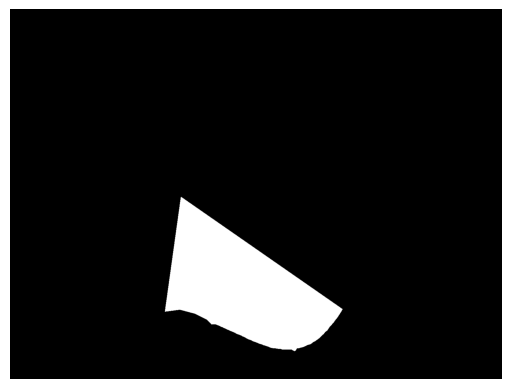

In [57]:
post_mask= limb_mask * post_poly_mask  # Combining the two masks to define the posterior of the limb
plt.imshow(post_mask, cmap='gray')
plt.axis('off') 

(-0.5, 1519.5, 1143.5, -0.5)

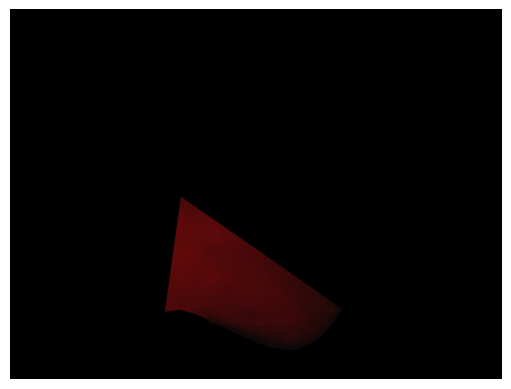

In [71]:
rfp = io.imread('2023-01-17_E24_cZRS_WT_RLD_63x_RFP_05s.jpg')
rfp[~post_mask] = 0
plt.imshow(rfp)
plt.axis('off')


(-0.5, 1519.5, 1143.5, -0.5)

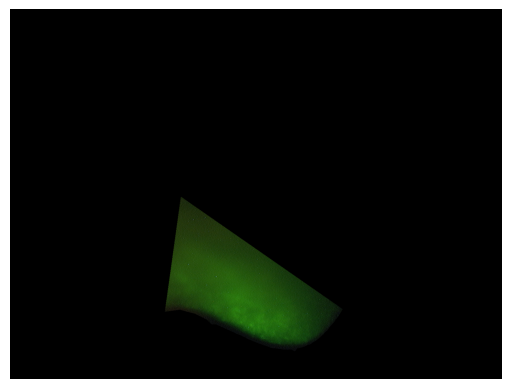

In [72]:
gfp = io.imread('2023-01-17_E24_cZRS_WT_RLD_63x_GFP_2s.jpg')
gfp[~post_mask] = 0
plt.imshow(gfp)
plt.axis('off')


ZPA MASK

In [ ]:
# draws the perpindicular line average slope with adjustments to intersects at midpoint coordinate
# cv2.circle(image, midpoint_left_perp, 10, (255, 255, 0), -1)
# cv2.circle(image, midpoint_right_perp, 10, (255, 255, 150), -1)
# cv2.line(image, midpoint_left_perp, midpoint_right_perp,color=(0, 255, 0), thickness=5)

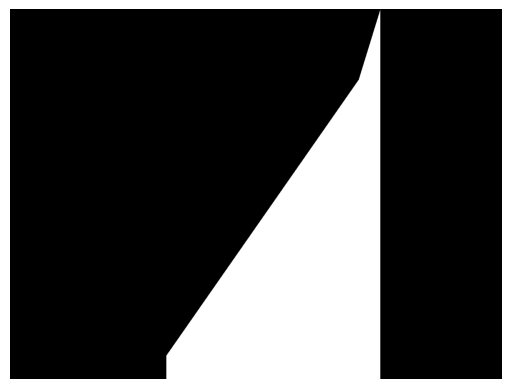

In [61]:
top_right = [image.shape[0], 0]
left_bottom = [midpoint_left_perp[0], image.shape[1]]
bottom_right = [image.shape[0], image.shape[1]]

polygon = [top_right, midpoint_right_perp, midpoint_left_perp, left_bottom, bottom_right] # list the polygon vertices
distal_poly_mask = polygon_mask(polygon, post_blur)
plt.imshow(distal_poly_mask, cmap='gray')
plt.axis('off') 


(-0.5, 1519.5, 1143.5, -0.5)

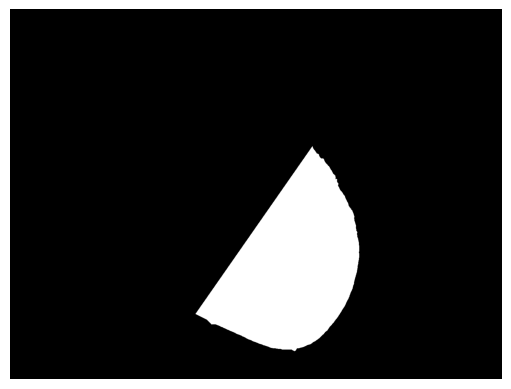

In [62]:
distal_mask = limb_mask * distal_poly_mask # Combining the two masks to define the distal region of the limb
plt.imshow(distal_mask, cmap='gray')
plt.axis('off') 

(-0.5, 1519.5, 1143.5, -0.5)

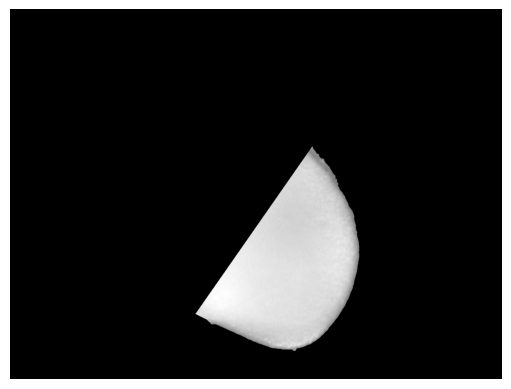

In [63]:
zpa_blur[~distal_mask] = 0
plt.imshow(zpa_blur, cmap='gray')
plt.axis('off')


left: (584, 926)
right: (1077, 775)
top: (923, 440)
bottom: (840, 1052)


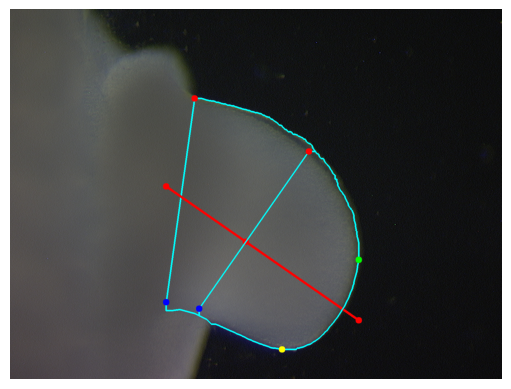

In [91]:
left2, right2, top2, bottom2 = find_extremes(zpa_blur)

(-0.5, 1519.5, 1143.5, -0.5)

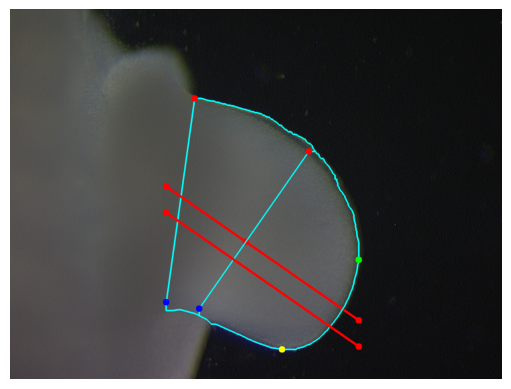

In [92]:
# Define the lower third of the limb
distance_x=top2[0]-left2[0]
distance_y=left2[1]-top2[1]
third_of_distance_x = round(distance_x/3)
if distance_x !=0:
    #For Slanted limb
    sixth_of_distance_y = round(distance_y/6)
    lower_third_left = [midpoint_left[0], midpoint_left[1]+sixth_of_distance_y]
    lower_third_right=[midpoint_right[0], midpoint_right[1]+sixth_of_distance_y]
else:
    #For right-angle limb
    distance_y = bottom2[1]-top2[1]
    sixth_of_distance_y = round(distance_y/6)
    lower_third_left = [midpoint_left[0], midpoint_left[1]+sixth_of_distance_y]
    lower_third_right=[midpoint_right[0], midpoint_right[1]+sixth_of_distance_y]


cv2.circle(image, lower_third_left, 10, (255, 0, 0), -1)
cv2.circle(image, lower_third_right, 10, (255, 0, 0), -1)
cv2.line(image, lower_third_left, lower_third_right, color=(255, 0, 0),thickness=5)
plt.imshow(image)
plt.axis('off')


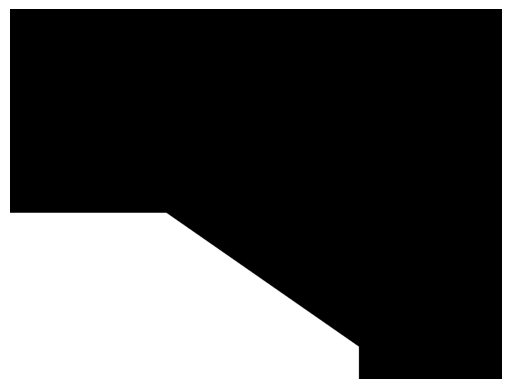

In [66]:
far_left = [0, lower_third_left[1]]
right_bottom = [lower_third_right[0], image.shape[1]]
left_bottom = [0, image.shape[1]]

polygon = [far_left, lower_third_left, lower_third_right, right_bottom, left_bottom] # list the polygon vertices
zpa_poly_mask = polygon_mask(polygon, post_blur)
plt.imshow(zpa_poly_mask, cmap='gray'), plt.axis('off') 

(-0.5, 1519.5, 1143.5, -0.5)

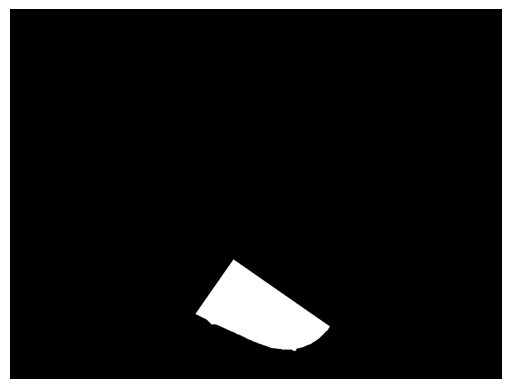

In [67]:
zpa_mask = distal_mask*zpa_poly_mask
plt.imshow(zpa_mask, cmap='gray'), plt.axis('off')

(-0.5, 1519.5, 1143.5, -0.5)

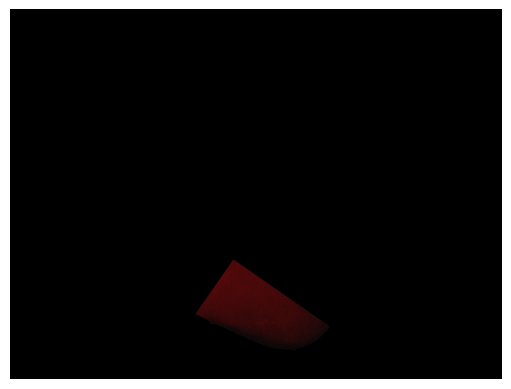

In [73]:
rfp = io.imread('2023-01-17_E24_cZRS_WT_RLD_63x_RFP_05s.jpg')
rfp[~zpa_mask] = 0
plt.imshow(rfp)
plt.axis('off')


(-0.5, 1519.5, 1143.5, -0.5)

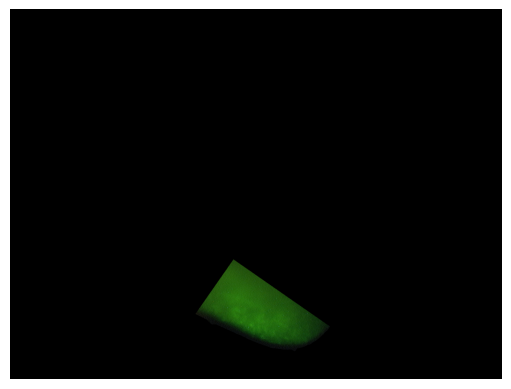

In [75]:
gfp = io.imread('2023-01-17_E24_cZRS_WT_RLD_63x_GFP_2s.jpg')
gfp[~zpa_mask] = 0
plt.imshow(gfp)
plt.axis('off')


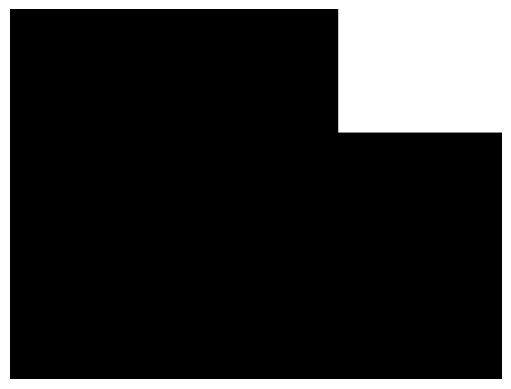

In [ ]:
# Mask for background normalization
row_3rd = round(image.shape[0]/3)
col_3rd = 2*(round(image.shape[1]/3))
top_mid = [col_3rd, -1]
top_right = [image.shape[1], -1]
right_mid = [image.shape[1], row_3rd]
left_mid = [col_3rd, row_3rd]

bg_polygon = [top_mid, top_right, right_mid, left_mid] #list the polygon vertices in order
bg_mask = polygon_mask(bg_polygon, image_blur)
plt.imshow(bg_mask, cmap='gray')
plt.axis('off')

### Defining the transfected region within the limb, based on RFP fluorescence and thresholding

(-0.5, 1519.5, 1143.5, -0.5)

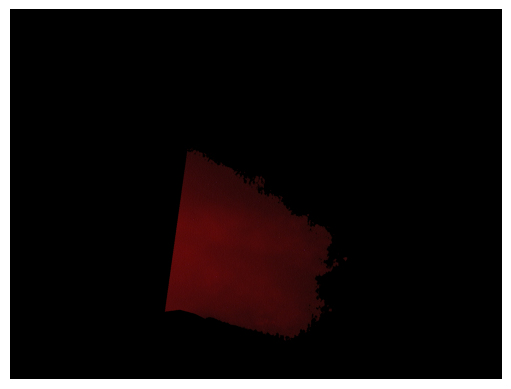

In [77]:
rfp_rgb = io.imread('2023-01-17_E24_cZRS_WT_RLD_63x_RFP_05s.jpg')
rfp_gray = cv2.cvtColor(rfp_rgb, cv2.COLOR_RGB2GRAY)
rfp_blur = cv2.bilateralFilter(rfp_gray, 9, 75, 75)
t = filters.threshold_otsu(rfp_blur)
rfp_thresh_mask= rfp_blur > t
rfp_mask = rfp_thresh_mask * limb_mask  # Combine the two masks to define the region of transfection
rfp_rgb[~rfp_mask] = 0
plt.imshow(rfp_rgb)
plt.axis('off')


### Measuring GFP within the transfected region

(-0.5, 1519.5, 1143.5, -0.5)

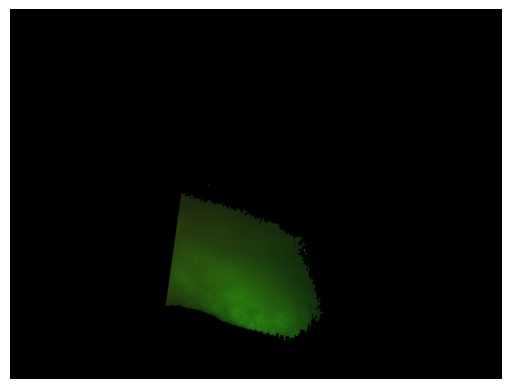

In [78]:
gfp_rgb = io.imread('2023-01-17_E24_cZRS_WT_RLD_63x_GFP_2s.jpg')
gfp_gray = cv2.cvtColor(gfp_rgb, cv2.COLOR_RGB2GRAY)
gfp_blur = cv2.bilateralFilter(gfp_gray, 9, 75, 75)
t = filters.threshold_otsu(gfp_blur)
gfp_thresh_mask = gfp_blur > t
gfp_mask = gfp_thresh_mask * rfp_mask
gfp_rgb[~gfp_mask] = 0
plt.imshow(gfp_rgb)
plt.axis('off')


## Step 9: Data Collection
>Measure fluorescence data and export as a Pandas dataframe and a csv file.

Measure fluorescence area, total intensity, and mean intensity for the masked RFP and GFP images, and normalize the GFP (Experiment) to RFP (Transfection Control).

In [30]:
def measure_fluor(rfp_blur, gfp_blur, rfp_mask, gfp_mask):
    # Measure RFP Fluorescence Data for the transfected region
    r_w = rfp_mask.shape[1]
    r_h = rfp_mask.shape[0]
    r_area = (r_w * r_h)
    r_pixel_count = np.count_nonzero(rfp_mask)  # Counts the pixels in the mask
    # Sum of the total pixel intensity
    r_intensity_sum = rfp_blur[rfp_mask].sum()
    # Gets the mean intensity of the pixels
    r_intensity_mean = rfp_blur[rfp_mask].mean()
    # This is just to help me see if the masking is right
    r_inv_mean = rfp_blur[~rfp_mask].mean()

    # Measure GFP fluorescence data for the transfected region
    g_w = gfp_mask.shape[1]
    g_h = gfp_mask.shape[0]
    g_area = (g_w * g_h)
    g_pixel_count = np.count_nonzero(gfp_mask)  # Counts the pixels in the mask
    # Sum of the total pixel intensity Should this be RFP mask or the GFP mask?
    g_intensity_sum = gfp_blur[gfp_mask].sum()
    # Gets the mean intensity of the pixels
    g_intensity_mean = gfp_blur[gfp_mask].mean()
    # This is just to help me see if the masking is right
    g_inv_mean = gfp_blur[~gfp_mask].mean()
    intensity_sum_norm = g_intensity_sum/r_intensity_sum
    fluor_data.append([intensity_sum_norm, r_area, r_pixel_count, r_intensity_sum, r_intensity_mean,
                       r_inv_mean, g_area, g_pixel_count, g_intensity_sum, g_intensity_mean, g_inv_mean])


# Creates a pandas df and a csv from the above function(s)
def make_df_csv(data_list, results_name):
    df = pd.DataFrame(data_list, columns=['intensity_sum_norm', 'r_area', 'r_pixel_count', 'r_intensity_sum',
                                          'r_intensity_mean', 'r_inv_mean', 'g_area', 'g_pixel_count', 'g_intensity_sum', 'g_intensity_mean', 'g_inv_mean'])
    # False means it won't add a column of arbitrary index values to the csv
    df.to_csv(results_name+'.csv', index=False)
    return df


fluor_data = []
measure_fluor(rfp_blur, gfp_blur, rfp_mask, gfp_mask)
df = make_df_csv(fluor_data, 'ZRS_results_1')


## Step 10: Putting it All Together
>To quickly iterate through multiple embryos, this step combines the above code, without the additional options, outputs, or checkpoints.

If you skipped the above steps, and do not want to make any changes or optimizations, you can use this cell to import only the modules needed for the final code.

In [ ]:
# Import only the modules needed for the final code
import os
import re
import numpy as np
import matplotlib.pylab as plt #Roipoly needs Matplotlib 3.5.1
from skimage import io, filters
import cv2
from roipoly import RoiPoly
import pandas as pd
from matplotlib.path import Path

In [ ]:
def select_embryos(path, mut_name, RFPexp='05s', GFPexp='2s'):
    embryos = []
    os.chdir(path)
    regex = re.compile(
        r'^(\d{4})-(\d{2})-(\d{2})_E(\d{2})_(.+)_(.+)_RLD_63x_([a-zA-Z]+)_([0-9]+)s\.(jpg|JPG|png|PNG|tif|TIF)$')
    for root, subdirs, files in os.walk(path):
        for name in files:
            if regex.match(name) and (mut_name in name):
                if ('Light' in name) or ('RFP' in name and RFPexp in name) or ('GFP' in name and GFPexp in name):
                    filepath = os.path.join(root, name)
                    if 'excld' not in filepath:
                        embryos.append(name)
    return embryos


def light_sort(elist):
    light_list = []
    for x in elist:
        if 'Light' in x:
            light_list.append(x)
    return light_list


def fluor_sort(light, elist, fluor):
    for x in elist:
        if (light.split('_')[0] in x) and (light.split('_')[1] in x) and (fluor in x):
            return x

# Isolate RGB channels
def rgb_decompose(img_rgb):
    # Create an empty array of the same shape as the input image
    null = np.zeros_like(img_rgb[:, :, 0]) 
    img_r = np.stack((img_rgb[:, :, 0], null, null), axis=-1)
    img_g = np.stack((null, img_rgb[:, :, 1], null), axis=-1)
    img_b = np.stack((null, null, img_rgb[:, :, 2]), axis=-1)
    # img_gb = np.stack((null, img_rgb[:, :, 1], img_rgb[:, :, 2]), axis=-1)
    return img_r, img_g, img_b


def find_extremes(img):
    # Find the extreme points of the limb using contours
    thresh = cv2.threshold(img, 60, 150, cv2.THRESH_BINARY)[1]
    # erosions and dilations to remove noise
    thresh = cv2.erode(thresh, None, iterations=10)
    thresh = cv2.dilate(thresh, None, iterations=10)
    cnts = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = cnts[0] if len(cnts) == 2 else cnts[1]
    c = max(cnts, key=cv2.contourArea)
    # Obtain outer coordinates
    left = tuple(c[c[:, :, 0].argmin()][0])
    right = tuple(c[c[:, :, 0].argmax()][0])
    top = tuple(c[c[:, :, 1].argmin()][0])
    bottom = tuple(c[c[:, :, 1].argmax()][0])
    # Optional, for visualization:
    # cv2.drawContours(img, [c], -1, (0, 255, 255), 2)
    # cv2.circle(img, left, 10, (0, 0, 255), -1)
    # cv2.circle(img, right, 10, (0, 255, 0), -1)
    # cv2.circle(img, top, 10, (255, 0, 0), -1)
    # cv2.circle(img, bottom, 10, (255, 255, 0), -1)
    return left, right, top, bottom, c

def slope_equation(pt1, pt2):  # defines the slope of the two points in the appropriate coordinate system
    list(pt1)
    list(pt2)
    slope = (pt2[1]-pt1[1])/(pt2[0]-pt1[0])
    intercept = pt2[1]-(slope*pt2[0])
    return slope, intercept


def polygon_mask(polygon_verts, img):  # List the polygon vertices in order
    poly_path = Path(polygon_verts)
    width = img.shape[0]
    height = img.shape[1]
    y, x = np.mgrid[:width, :height]
    coors = np.hstack((x.reshape(-1, 1), y.reshape(-1, 1)))
    mask1 = poly_path.contains_points(coors)
    mask2 = mask1.reshape(width, height)
    return mask2

def process_limb(light, elist):
    %matplotlib auto
    rfp = fluor_sort(light, elist, 'RFP')
    gfp = fluor_sort(light, elist, 'GFP')
    e_name = '_'.join(light.split('_')[0:2])
    e_mut = '_'.join(light.split('_')[2:4])
    light_image = io.imread(light)
    light_gray = cv2.cvtColor(light_image, cv2.COLOR_RGB2GRAY) #The image is in RGB format because it was opened with io
    # Bilateral Filtering: a Gaussian blur filter that preserves edges
    light_blur = cv2.bilateralFilter(light_gray, 9, 75, 75)
    post_blur = light_blur #For creating posterior mask
    zpa_blur = light_blur #For creating ZPA mask
    bg_blur = light_blur #For creating background mask
    # Should use gray image
    plt.imshow(light_blur, cmap='gray'), plt.axis('off')
    # Draw new ROI in red, left click to add new point, right click to close ROI
    roi = RoiPoly(color='r')
    roi_mask = roi.get_mask(light_blur)
    # Define edges of the limb using selected thresholding method
    t = filters.threshold_otsu(light_blur)
    light_thresh_mask = light_blur > t
    limb_mask = light_thresh_mask * roi_mask  # Combine the two masks to define the limb region

    # Mask for background normalization
    row_3rd = round(light_image.shape[0]/3)
    col_3rd = 2*(round(light_image.shape[1]/3))
    top_mid = [col_3rd, -1]
    top_rt = [light_image.shape[1], -1]
    right_mid = [light_image.shape[1], row_3rd]
    left_mid = [col_3rd, row_3rd]

    bg_verts = [top_mid, top_rt, right_mid, left_mid] 
    bg_mask = polygon_mask(bg_verts, bg_blur)

    rfp_rgb = io.imread(rfp)
    rfp_rgb_gray = cv2.cvtColor(rfp_rgb, cv2.COLOR_RGB2GRAY) #The image is in RGB format because it was opened with io
    rfp_rgb_blur = cv2.bilateralFilter(rfp_rgb_gray, 9, 75, 75)
    t = filters.threshold_otsu(rfp_rgb_blur)
    rfp_rgb_thresh_mask = rfp_rgb_blur > t
    rfp_rgb_mask = rfp_rgb_thresh_mask * limb_mask  # Combine the two masks to define the transfection region
    
    rfp_rgb = io.imread(rfp)
    rfp_r, rfp_g, rfp_b = rgb_decompose(rfp_rgb) #make a new image with only the red channel values
    rfp_r_gray = cv2.cvtColor(rfp_r, cv2.COLOR_RGB2GRAY) #The image is in RGB format because it was opened with io
    rfp_r_blur = cv2.bilateralFilter(rfp_r_gray, 9, 75, 75)
    t = filters.threshold_otsu(rfp_r_blur)
    rfp_r_thresh_mask = rfp_r_blur > t
    rfp_r_mask  = rfp_r_thresh_mask * limb_mask  # Combine the two masks to define the transfection region

    gfp_rgb = io.imread(gfp)
    gfp_rgb_gray = cv2.cvtColor(gfp_rgb, cv2.COLOR_RGB2GRAY) #The image is in RGB format because it was opened with io
    gfp_rgb_blur = cv2.bilateralFilter(gfp_rgb_gray, 9, 75, 75)
    t = filters.threshold_otsu(gfp_rgb_blur)
    gfp_rgb_thresh_mask = gfp_rgb_blur > t
    gfp_rgb_mask = gfp_rgb_thresh_mask * rfp_rgb_mask  # Combine the two masks to define the region of GFP activity

    gfp_rgb = io.imread(gfp)
    gfp_r, gfp_g, gfp_b = rgb_decompose(gfp_rgb) #make a new image with only the green channel values
    gfp_g_gray = cv2.cvtColor(gfp_g, cv2.COLOR_RGB2GRAY) #The image is in RGB format because it was opened with io
    gfp_g_blur = cv2.bilateralFilter(gfp_g_gray, 9, 75, 75)
    t = filters.threshold_otsu(gfp_g_blur)
    gfp_g_thresh_mask = gfp_g_blur > t
    gfp_g_mask = gfp_g_thresh_mask * rfp_rgb_mask  # Combine the two masks to define the region of GFP activity

    # Posterior mask code
    post_blur[~limb_mask] = 0
    left1, right1, top1, bottom1, c1 = find_extremes(post_blur)
    list_right=list(right1) #converts right tuple into a list
    list_right[0]-=349 # Substracts 500um/349px from the x coordinate of the right point
    midpoint=tuple(list_right) #convert list of right coordinate back into tuple

    slope1, intercept1 = slope_equation(right1, top1)
    slope2, intercept2 = slope_equation(bottom1, left1)
    slope_ratio = slope1/slope2
    if slope_ratio > 0.1:
        # for slanted limbs
        avg_slope = (slope1+slope2)/2
        avg_intercept = (intercept1+intercept2)/2
        y = round((avg_slope) * midpoint[0] + (avg_intercept))
        midpoint_adj = [midpoint[0], y]
        perp_slope = (np.reciprocal(avg_slope))*-1
        perp_intercept = round(midpoint_adj[1]+(-perp_slope*midpoint_adj[0]))
        y_left = round((avg_slope)*left1[0]+(avg_intercept))
        midpoint_left = [left1[0], y_left]
        y_right = round((avg_slope)*right1[0]+(avg_intercept))
        midpoint_right = [right1[0], y_right]
        y_left_perp = round((perp_slope)*left1[0]+(perp_intercept))
        midpoint_left_perp = [left1[0], y_left_perp]
        y_right_perp = round((perp_slope)*right1[0]+(perp_intercept))
        midpoint_right_perp = [right1[0], y_right_perp]
    else:
        # for right-angle limbs
        avg_slope = 0 
        avg_intercept = midpoint[1]
        midpoint_adj = midpoint
        midpoint_left = [left1[0], right1[1]]
        midpoint_right = right1
        midpoint_left_perp = [midpoint[0], bottom1[1]]
        midpoint_right_perp = [midpoint[0], top1[1]]
        avg_slope = (slope1+slope2)/2
        avg_intercept = (intercept1+intercept2)/2
        half = round((bottom1[1]-top1[1])/2)
        half_coord_l = [bottom1[0], bottom1[1]-half]
        half_coord_r = [right1[0], half_coord_l[1]]
        if half_coord_l[1] < midpoint_left[1]:
            midpoint_left = half_coord_l
            midpoint_right = half_coord_r
            midpoint_adj = [midpoint[0], half_coord_l[1]]
    
    far_left = [0, midpoint_left[1]]
    right_bottom = [midpoint_right[0], roi_mask.shape[1]]
    left_bottom = [0, roi_mask.shape[1]]
    
    post_verts = [far_left, midpoint_left, midpoint_right, right_bottom, left_bottom] 
    post_poly_mask = polygon_mask(post_verts, post_blur)
    post_mask= limb_mask * post_poly_mask  # Combining the two masks to define the posterior of the limb

    # ZPA mask code
    top_right = [roi_mask.shape[0], 0]
    left_bottom = [midpoint_left_perp[0], roi_mask.shape[1]]
    bottom_right = [roi_mask.shape[0], roi_mask.shape[1]]
    distal_verts = [top_right, midpoint_right_perp, midpoint_left_perp, left_bottom, bottom_right] 
    distal_poly_mask = polygon_mask(distal_verts, post_blur)
    distal_mask = limb_mask * distal_poly_mask # Combining the two masks to define the distal region of the limb
    zpa_blur[~distal_mask] = 0
    left2, right2, top2, bottom2, c2 = find_extremes(zpa_blur)
    
    # Define the lower third of the limb
    distance_x = top2[0]-left2[0]
    distance_y = left2[1]-top2[1]
    if distance_x != 0:
        #For slanted limb
        sixth_of_distance_y = round(distance_y/6)
        lower_third_left = [midpoint_left[0], midpoint_left[1]+sixth_of_distance_y]
        lower_third_right=[midpoint_right[0], midpoint_right[1]+sixth_of_distance_y]
    else:
        #For right-angle limb
        distance_y = bottom2[1]-top2[1]
        sixth_of_distance_y = round(distance_y/6)
        lower_third_left = [midpoint_left[0], midpoint_left[1]+sixth_of_distance_y]
        lower_third_right=[midpoint_right[0], midpoint_right[1]+sixth_of_distance_y]

    far_left = [0, lower_third_left[1]]
    right_bottom = [lower_third_right[0], roi_mask.shape[1]]
    left_bottom = [0, roi_mask.shape[1]]
    zpa_verts = [far_left, lower_third_left, lower_third_right, right_bottom, left_bottom] 
    zpa_poly_mask = polygon_mask(zpa_verts, post_blur)
    zpa_mask = distal_mask*zpa_poly_mask

    # Measure RFP fluorescence data for the transfected region using RGB image
    rfp_rgb_limb_pixel_ct = np.count_nonzero(rfp_rgb_mask)  # Counts the pixels in the mask
    rfp_rgb_limb_i_sum = rfp_rgb_blur[rfp_rgb_mask].sum() # Sum of the total pixel intensity
    rfp_rgb_limb_i_mean = rfp_rgb_blur[rfp_rgb_mask].mean() # Gets the mean intensity of the pixels
    rfp_rgb_post_mask = rfp_rgb_mask * post_mask # Repeat, but within the posterior region of the limb
    rfp_rgb_post_pixel_ct = np.count_nonzero(rfp_rgb_post_mask)
    rfp_rgb_post_i_sum = rfp_rgb_blur[rfp_rgb_post_mask].sum()
    rfp_rgb_post_i_mean = rfp_rgb_blur[rfp_rgb_post_mask].mean()
    rfp_rgb_zpa_mask = rfp_rgb_mask * zpa_mask  # Repeat, but within the ZPA
    rfp_rgb_zpa_pixel_ct = np.count_nonzero(rfp_rgb_zpa_mask)
    rfp_rgb_zpa_i_sum = rfp_rgb_blur[rfp_rgb_zpa_mask].sum()
    rfp_rgb_zpa_i_mean = rfp_rgb_blur[rfp_rgb_zpa_mask].mean()

    # Measure RFP fluorescence data for the transfected region using r channel only
    rfp_r_limb_pixel_ct = np.count_nonzero(rfp_r_mask)  # Counts the pixels in the mask
    rfp_r_limb_i_sum = rfp_r_blur[rfp_r_mask].sum() # Sum of the total pixel intensity
    rfp_r_limb_i_mean = rfp_r_blur[rfp_r_mask].mean() # Gets the mean intensity of the pixels
    rfp_r_post_mask = rfp_r_mask * post_mask # Repeat, but within the posterior region of the limb
    rfp_r_post_pixel_ct = np.count_nonzero(rfp_r_post_mask)
    rfp_r_post_i_sum = rfp_r_blur[rfp_r_post_mask].sum()
    rfp_r_post_i_mean = rfp_r_blur[rfp_r_post_mask].mean()
    rfp_r_zpa_mask = rfp_r_mask * zpa_mask  # Repeat, but within the ZPA
    rfp_r_zpa_pixel_ct = np.count_nonzero(rfp_r_zpa_mask)
    rfp_r_zpa_i_sum = rfp_r_blur[rfp_r_zpa_mask].sum()
    rfp_r_zpa_i_mean = rfp_r_blur[rfp_r_zpa_mask].mean()

    # Measure GFP fluorescence data for the transfected region using RGB image
    gfp_rgb_limb_pixel_ct = np.count_nonzero(gfp_rgb_mask)  # Counts the pixels in the mask
    gfp_rgb_limb_i_sum = gfp_rgb_blur[gfp_rgb_mask].sum() # Sum of the total pixel intensity
    gfp_rgb_limb_i_mean = gfp_rgb_blur[gfp_rgb_mask].mean() # Gets the mean intensity of the pixels
    gfp_rgb_post_mask = gfp_rgb_mask * post_mask # Repeat, but within the posterior region of the limb
    gfp_rgb_post_pixel_ct = np.count_nonzero(gfp_rgb_post_mask)
    gfp_rgb_post_i_sum = gfp_rgb_blur[gfp_rgb_post_mask].sum()
    gfp_rgb_post_i_mean = gfp_rgb_blur[gfp_rgb_post_mask].mean()
    gfp_rgb_zpa_mask = gfp_rgb_mask * zpa_mask  # Repeat, but within the ZPA
    gfp_rgb_zpa_pixel_ct = np.count_nonzero(gfp_rgb_zpa_mask)
    gfp_rgb_zpa_i_sum = gfp_rgb_blur[gfp_rgb_zpa_mask].sum()
    gfp_rgb_zpa_i_mean = gfp_rgb_blur[gfp_rgb_zpa_mask].mean()

    # Measure GFP fluorescence data for the transfected region using g channel only
    gfp_g_limb_pixel_ct = np.count_nonzero(gfp_g_mask)  # Counts the pixels in the mask
    gfp_g_limb_i_sum = gfp_g_blur[gfp_g_mask].sum() # Sum of the total pixel intensity
    gfp_g_limb_i_mean = gfp_g_blur[gfp_g_mask].mean() # Gets the mean intensity of the pixels
    gfp_g_post_mask = gfp_g_mask * post_mask # Repeat, but within the posterior region of the limb
    gfp_g_post_pixel_ct = np.count_nonzero(gfp_g_post_mask)
    gfp_g_post_i_sum = gfp_g_blur[gfp_g_post_mask].sum()
    gfp_g_post_i_mean = gfp_g_blur[gfp_g_post_mask].mean()
    gfp_g_zpa_mask = gfp_g_mask * zpa_mask  # Repeat, but within the ZPA
    gfp_g_zpa_pixel_ct = np.count_nonzero(gfp_g_zpa_mask)
    gfp_g_zpa_i_sum = gfp_g_blur[gfp_g_zpa_mask].sum()
    gfp_g_zpa_i_mean = gfp_g_blur[gfp_g_zpa_mask].mean()

    # Sum method, without bg subtraction
    rgb_rgb_limb_i_sum_norm = gfp_rgb_limb_i_sum/rfp_rgb_limb_i_sum
    rgb_rgb_post_i_sum_norm = gfp_rgb_post_i_sum/rfp_rgb_post_i_sum
    rgb_rgb_zpa_i_sum_norm = gfp_rgb_zpa_i_sum/rfp_rgb_zpa_i_sum

    g_rgb_limb_i_sum_norm = gfp_g_limb_i_sum/rfp_rgb_limb_i_sum
    g_rgb_post_i_sum_norm = gfp_g_post_i_sum/rfp_rgb_post_i_sum
    g_rgb_zpa_i_sum_norm = gfp_g_zpa_i_sum/rfp_rgb_zpa_i_sum

    g_r_limb_i_sum_norm = gfp_g_limb_i_sum/rfp_r_limb_i_sum
    g_r_post_i_sum_norm = gfp_g_post_i_sum/rfp_r_post_i_sum
    g_r_zpa_i_sum_norm = gfp_g_zpa_i_sum/rfp_r_zpa_i_sum

    # Mean method, without bg subtraction
    rgb_rgb_limb_i_mean_norm = gfp_rgb_limb_i_mean/rfp_rgb_limb_i_mean
    rgb_rgb_post_i_mean_norm = gfp_rgb_post_i_mean/rfp_rgb_post_i_mean
    rgb_rgb_zpa_i_mean_norm = gfp_rgb_zpa_i_mean/rfp_rgb_zpa_i_mean

    g_rgb_limb_i_mean_norm = gfp_g_limb_i_mean/rfp_rgb_limb_i_mean
    g_rgb_post_i_mean_norm = gfp_g_post_i_mean/rfp_rgb_post_i_mean
    g_rgb_zpa_i_mean_norm = gfp_g_zpa_i_mean/rfp_rgb_zpa_i_mean

    g_r_limb_i_mean_norm = gfp_g_limb_i_mean/rfp_r_limb_i_mean
    g_r_post_i_mean_norm = gfp_g_post_i_mean/rfp_r_post_i_mean
    g_r_zpa_i_mean_norm = gfp_g_zpa_i_mean/rfp_r_zpa_i_mean
    
    #Background measurements for all images
    rfp_rgb_bg_i_mean = rfp_rgb_blur[bg_mask].mean()
    rfp_r_bg_i_mean = rfp_r_blur[bg_mask].mean()
    gfp_rgb_bg_i_mean = gfp_rgb_blur[bg_mask].mean()
    gfp_g_bg_i_mean = gfp_g_blur[bg_mask].mean()

    # Artificial 'sum' values calculated to match ROI pixel number
    rfp_rgb_limb_bg_i_sum = rfp_rgb_bg_i_mean*rfp_rgb_limb_pixel_ct
    rfp_rgb_post_bg_i_sum = rfp_rgb_bg_i_mean*rfp_rgb_post_pixel_ct
    rfp_rgb_zpa_bg_i_sum = rfp_rgb_bg_i_mean*rfp_rgb_zpa_pixel_ct
    
    rfp_r_limb_bg_i_sum = rfp_r_bg_i_mean*rfp_r_limb_pixel_ct
    rfp_r_post_bg_i_sum = rfp_r_bg_i_mean*rfp_r_post_pixel_ct
    rfp_r_zpa_bg_i_sum = rfp_r_bg_i_mean*rfp_r_zpa_pixel_ct

    gfp_rgb_limb_bg_i_sum = gfp_rgb_bg_i_mean*gfp_rgb_limb_pixel_ct
    gfp_rgb_post_bg_i_sum = gfp_rgb_bg_i_mean*gfp_rgb_post_pixel_ct
    gfp_rgb_zpa_bg_i_sum = gfp_rgb_bg_i_mean*gfp_rgb_zpa_pixel_ct

    gfp_g_limb_bg_i_sum = gfp_g_bg_i_mean*gfp_g_limb_pixel_ct
    gfp_g_post_bg_i_sum = gfp_g_bg_i_mean*gfp_g_post_pixel_ct
    gfp_g_zpa_bg_i_sum = gfp_g_bg_i_mean*gfp_g_zpa_pixel_ct
    
    # Bg-subtracted sum values
    rfp_rgb_limb_i_sum_bg_sub = rfp_rgb_limb_i_sum-rfp_rgb_limb_bg_i_sum
    rfp_rgb_post_i_sum_bg_sub = rfp_rgb_post_i_sum-rfp_rgb_post_bg_i_sum
    rfp_rgb_zpa_i_sum_bg_sub = rfp_rgb_zpa_i_sum-rfp_rgb_zpa_bg_i_sum

    rfp_r_limb_i_sum_bg_sub = rfp_r_limb_i_sum-rfp_r_limb_bg_i_sum
    rfp_r_post_i_sum_bg_sub = rfp_r_post_i_sum-rfp_r_post_bg_i_sum
    rfp_r_zpa_i_sum_bg_sub = rfp_r_zpa_i_sum-rfp_r_zpa_bg_i_sum

    gfp_rgb_limb_i_sum_bg_sub = gfp_rgb_limb_i_sum-gfp_rgb_limb_bg_i_sum
    gfp_rgb_post_i_sum_bg_sub = gfp_rgb_post_i_sum-gfp_rgb_post_bg_i_sum
    gfp_rgb_zpa_i_sum_bg_sub = gfp_rgb_zpa_i_sum-gfp_rgb_zpa_bg_i_sum

    gfp_g_limb_i_sum_bg_sub = gfp_g_limb_i_sum-gfp_g_limb_bg_i_sum
    gfp_g_post_i_sum_bg_sub = gfp_g_post_i_sum-gfp_g_post_bg_i_sum
    gfp_g_zpa_i_sum_bg_sub = gfp_g_zpa_i_sum-gfp_g_zpa_bg_i_sum

    # Bg-subtracted mean values
    rfp_rgb_limb_i_mean_bg_sub = rfp_rgb_limb_i_mean-rfp_rgb_bg_i_mean
    rfp_rgb_post_i_mean_bg_sub = rfp_rgb_post_i_mean-rfp_rgb_bg_i_mean
    rfp_rgb_zpa_i_mean_bg_sub = rfp_rgb_zpa_i_mean-rfp_rgb_bg_i_mean

    rfp_r_limb_i_mean_bg_sub = rfp_r_limb_i_mean-rfp_r_bg_i_mean
    rfp_r_post_i_mean_bg_sub = rfp_r_post_i_mean-rfp_r_bg_i_mean
    rfp_r_zpa_i_mean_bg_sub = rfp_r_zpa_i_mean-rfp_r_bg_i_mean

    gfp_rgb_limb_i_mean_bg_sub = gfp_rgb_limb_i_mean-gfp_rgb_bg_i_mean
    gfp_rgb_post_i_mean_bg_sub = gfp_rgb_post_i_mean-gfp_rgb_bg_i_mean
    gfp_rgb_zpa_i_mean_bg_sub = gfp_rgb_zpa_i_mean-gfp_rgb_bg_i_mean

    gfp_g_limb_i_mean_bg_sub = gfp_g_limb_i_mean-gfp_g_bg_i_mean
    gfp_g_post_i_mean_bg_sub = gfp_g_post_i_mean-gfp_g_bg_i_mean
    gfp_g_zpa_i_mean_bg_sub = gfp_g_zpa_i_mean-gfp_g_bg_i_mean

    # Sum method, with bg subtraction
    rgb_rgb_limb_i_sum_norm_bg_sub = gfp_rgb_limb_i_sum_bg_sub/rfp_rgb_limb_i_sum_bg_sub
    rgb_rgb_post_i_sum_norm_bg_sub = gfp_rgb_post_i_sum_bg_sub/rfp_rgb_post_i_sum_bg_sub
    rgb_rgb_zpa_i_sum_norm_bg_sub = gfp_rgb_zpa_i_sum_bg_sub/rfp_rgb_zpa_i_sum_bg_sub
    
    g_rgb_limb_i_sum_norm_bg_sub = gfp_g_limb_i_sum_bg_sub/rfp_rgb_limb_i_sum_bg_sub
    g_rgb_post_i_sum_norm_bg_sub = gfp_g_post_i_sum_bg_sub/rfp_rgb_post_i_sum_bg_sub
    g_rgb_zpa_i_sum_norm_bg_sub = gfp_g_zpa_i_sum_bg_sub/rfp_rgb_zpa_i_sum_bg_sub

    g_r_limb_i_sum_norm_bg_sub = gfp_g_limb_i_sum_bg_sub/rfp_r_limb_i_sum_bg_sub
    g_r_post_i_sum_norm_bg_sub = gfp_g_post_i_sum_bg_sub/rfp_r_post_i_sum_bg_sub
    g_r_zpa_i_sum_norm_bg_sub = gfp_g_zpa_i_sum_bg_sub/rfp_r_zpa_i_sum_bg_sub

    # Mean method, with bg subtraction
    rgb_rgb_limb_i_mean_norm_bg_sub = gfp_rgb_limb_i_mean_bg_sub/rfp_rgb_limb_i_mean_bg_sub
    rgb_rgb_post_i_mean_norm_bg_sub = gfp_rgb_post_i_mean_bg_sub/rfp_rgb_post_i_mean_bg_sub
    rgb_rgb_zpa_i_mean_norm_bg_sub = gfp_rgb_zpa_i_mean_bg_sub/rfp_rgb_zpa_i_mean_bg_sub
    
    g_rgb_limb_i_mean_norm_bg_sub = gfp_g_limb_i_mean_bg_sub/rfp_rgb_limb_i_mean_bg_sub
    g_rgb_post_i_mean_norm_bg_sub = gfp_g_post_i_mean_bg_sub/rfp_rgb_post_i_mean_bg_sub
    g_rgb_zpa_i_mean_norm_bg_sub = gfp_g_zpa_i_mean_bg_sub/rfp_rgb_zpa_i_mean_bg_sub
    
    g_r_limb_i_mean_norm_bg_sub = gfp_g_limb_i_mean_bg_sub/rfp_r_limb_i_mean_bg_sub
    g_r_post_i_mean_norm_bg_sub = gfp_g_post_i_mean_bg_sub/rfp_r_post_i_mean_bg_sub
    g_r_zpa_i_mean_norm_bg_sub = gfp_g_zpa_i_mean_bg_sub/rfp_r_zpa_i_mean_bg_sub


    #For bleed-through analysis
    rfp_rgb_sum = rfp_rgb[limb_mask].sum()
    rfp_r_sum = rfp_r[limb_mask].sum()
    rfp_g_sum = rfp_g[limb_mask].sum()
    rfp_b_sum = rfp_b[limb_mask].sum()

    gfp_rgb_sum = gfp_rgb[limb_mask].sum()
    gfp_r_sum = gfp_r[limb_mask].sum()
    gfp_g_sum = gfp_g[limb_mask].sum()
    gfp_b_sum = gfp_b[limb_mask].sum()
    
    rfp_r_percent = (rfp_r_sum/rfp_rgb_sum)*100
    rfp_g_percent = (rfp_g_sum/rfp_rgb_sum)*100
    rfp_b_percent = (rfp_b_sum/rfp_rgb_sum)*100
    gfp_r_percent = (gfp_r_sum/gfp_rgb_sum)*100
    gfp_g_percent = (gfp_g_sum/gfp_rgb_sum)*100
    gfp_b_percent = (gfp_b_sum/gfp_rgb_sum)*100


    fluor_data.append([e_name, e_mut, # Identifying info
                    # Sum method, without bg subtraction
                    rgb_rgb_limb_i_sum_norm, rgb_rgb_post_i_sum_norm, rgb_rgb_zpa_i_sum_norm, 
                    g_rgb_limb_i_sum_norm, g_rgb_post_i_sum_norm, g_rgb_zpa_i_sum_norm, 
                    g_r_limb_i_sum_norm, g_r_post_i_sum_norm, g_r_zpa_i_sum_norm,
                    # Mean method, without bg subtraction
                    rgb_rgb_limb_i_mean_norm, rgb_rgb_post_i_mean_norm, rgb_rgb_zpa_i_mean_norm,
                    g_rgb_limb_i_mean_norm, g_rgb_post_i_mean_norm, g_rgb_zpa_i_mean_norm,
                    g_r_limb_i_mean_norm, g_r_post_i_mean_norm, g_r_zpa_i_mean_norm,
                    # Sum method, with bg subtraction
                    rgb_rgb_limb_i_sum_norm_bg_sub, rgb_rgb_post_i_sum_norm_bg_sub, rgb_rgb_zpa_i_sum_norm_bg_sub,
                    g_rgb_limb_i_sum_norm_bg_sub, g_rgb_post_i_sum_norm_bg_sub, g_rgb_zpa_i_sum_norm_bg_sub,
                    g_r_limb_i_sum_norm_bg_sub, g_r_post_i_sum_norm_bg_sub, g_r_zpa_i_sum_norm_bg_sub,
                    # Mean method, with bg subtraction
                    rgb_rgb_limb_i_mean_norm_bg_sub, rgb_rgb_post_i_mean_norm_bg_sub, rgb_rgb_zpa_i_mean_norm_bg_sub,
                    g_rgb_limb_i_mean_norm_bg_sub, g_rgb_post_i_mean_norm_bg_sub, g_rgb_zpa_i_mean_norm_bg_sub,
                    g_r_limb_i_mean_norm_bg_sub, g_r_post_i_mean_norm_bg_sub, g_r_zpa_i_mean_norm_bg_sub,
                    # Background measurements
                    rfp_rgb_bg_i_mean, rfp_r_bg_i_mean, gfp_rgb_bg_i_mean, gfp_g_bg_i_mean,
                    # Channel percentages for RGB decomposition analysis
                    rfp_r_percent, rfp_g_percent, rfp_b_percent, gfp_r_percent, gfp_g_percent, gfp_b_percent, 
                    # Other values to doubles check calcs
                    rfp_rgb_limb_pixel_ct, rfp_rgb_limb_i_sum, rfp_rgb_limb_i_mean, rfp_rgb_limb_i_sum_bg_sub, rfp_rgb_limb_i_mean_bg_sub,
                    rfp_rgb_post_pixel_ct, rfp_rgb_post_i_sum, rfp_rgb_post_i_mean, rfp_rgb_post_i_sum_bg_sub, rfp_rgb_post_i_mean_bg_sub,
                    rfp_rgb_zpa_pixel_ct, rfp_rgb_zpa_i_sum, rfp_rgb_zpa_i_mean, rfp_rgb_zpa_i_sum_bg_sub, rfp_rgb_zpa_i_mean_bg_sub,
                    rfp_r_limb_pixel_ct, rfp_r_limb_i_sum, rfp_r_limb_i_mean, rfp_r_limb_i_sum_bg_sub, rfp_r_limb_i_mean_bg_sub,
                    rfp_r_post_pixel_ct, rfp_r_post_i_sum, rfp_r_post_i_mean, rfp_r_post_i_sum_bg_sub, rfp_r_post_i_mean_bg_sub,
                    rfp_r_zpa_pixel_ct, rfp_r_zpa_i_sum, rfp_r_zpa_i_mean, rfp_r_zpa_i_sum_bg_sub, rfp_r_zpa_i_mean_bg_sub,
                    gfp_rgb_limb_pixel_ct, gfp_rgb_limb_i_sum, gfp_rgb_limb_i_mean, gfp_rgb_limb_i_sum_bg_sub, gfp_rgb_limb_i_mean_bg_sub, 
                    gfp_rgb_post_pixel_ct, gfp_rgb_post_i_sum, gfp_rgb_post_i_mean, gfp_rgb_post_i_sum_bg_sub, gfp_rgb_post_i_mean_bg_sub, 
                    gfp_rgb_zpa_pixel_ct, gfp_rgb_zpa_i_sum, gfp_rgb_zpa_i_mean, gfp_rgb_zpa_i_sum_bg_sub, gfp_rgb_zpa_i_mean_bg_sub,
                    gfp_g_limb_pixel_ct, gfp_g_limb_i_sum, gfp_g_limb_i_mean, gfp_g_limb_i_sum_bg_sub, gfp_g_limb_i_mean_bg_sub,
                    gfp_g_post_pixel_ct, gfp_g_post_i_sum, gfp_g_post_i_mean, gfp_g_post_i_sum_bg_sub, gfp_g_post_i_mean_bg_sub,
                    gfp_g_zpa_pixel_ct, gfp_g_zpa_i_sum, gfp_g_zpa_i_mean, gfp_g_zpa_i_sum_bg_sub, gfp_g_zpa_i_mean_bg_sub,
                    ])
    %matplotlib inline

    #Visualize the output
    fig, axes = plt.subplots(4, 4, figsize=(20, 15), sharex=True, sharey=True)
    fig.suptitle(f'{e_name} {e_mut}', fontsize=16)
    ax = axes.ravel()

    ax[0].imshow(light_image)
    ax[0].set_title('Light Original', fontsize=12)
    
    cv2.drawContours(light_image, [c1], -1, (0, 255, 255), 2)
    cv2.circle(light_image, left1, 10, (0, 0, 255), -1)
    cv2.circle(light_image, right1, 10, (0, 255, 0), -1)
    cv2.circle(light_image, top1, 10, (255, 0, 0), -1)
    cv2.circle(light_image, bottom1, 10, (255, 255, 0), -1)
    ax[1].imshow(light_image)
    ax[1].set_title('Contour and Extreme Points', fontsize=12)

    cv2.circle(light_image, midpoint_left, 10, (100, 255, 0), -1)
    cv2.circle(light_image, midpoint_right, 10, (100, 255, 150), -1)
    cv2.line(light_image, midpoint_right, midpoint_left, color=(0, 255, 0), thickness=5)
    ax[2].imshow(light_image)
    ax[2].set_title('Midline', fontsize=12)

    cv2.drawContours(light_image, [c2], -1, (0, 255, 255), 2)
    cv2.circle(light_image, left2, 10, (0, 0, 255), -1)
    cv2.circle(light_image, right2, 10, (0, 255, 0), -1)
    cv2.circle(light_image, top2, 10, (255, 0, 0), -1)
    cv2.circle(light_image, bottom2, 10, (255, 255, 0), -1)
    cv2.circle(light_image, midpoint_left_perp, 10, (255, 255, 0), -1)
    cv2.circle(light_image, midpoint_right_perp, 10, (255, 255, 150), -1)
    cv2.line(light_image, midpoint_left_perp, midpoint_right_perp, color=(0, 255, 0), thickness=5)
    cv2.circle(light_image, lower_third_right, 10, (255, 255, 0), -1)
    cv2.line(light_image, lower_third_left, lower_third_right, color=(0, 255, 0), thickness=5)
    ax[3].imshow(light_image)
    ax[3].set_title('Lower Third', fontsize=12)

    ax[4].imshow(rfp_rgb)
    ax[4].set_title('RFP Orignal', fontsize=12)

    rfp_rgb = io.imread(rfp)
    rfp_rgb[~rfp_rgb_mask] = 0
    ax[5].imshow(rfp_rgb)
    ax[5].set_title('Limb Mask', fontsize=12)

    rfp_rgb = io.imread(rfp)
    rfp_rgb[~rfp_rgb_post_mask] = 0
    ax[6].imshow(rfp_rgb)
    ax[6].set_title('Post Mask', fontsize=12)
    
    rfp_rgb = io.imread(rfp)
    rfp_rgb[~rfp_rgb_zpa_mask] = 0
    ax[7].imshow(rfp_rgb)
    ax[7].set_title('ZPA Mask', fontsize=12)

    ax[8].imshow(gfp_rgb)
    ax[8].set_title('GFP Orignal', fontsize=12)

    gfp_rgb = io.imread(gfp)
    gfp_rgb[~gfp_rgb_mask] = 0
    ax[9].imshow(gfp_rgb)
    ax[9].set_title('Limb RGB Mask', fontsize=12)

    gfp_rgb = io.imread(gfp)
    gfp_rgb[~gfp_rgb_post_mask] = 0
    ax[10].imshow(gfp_rgb)
    ax[10].set_title('Post RGB Mask', fontsize=12)

    gfp_rgb = io.imread(gfp)
    gfp_rgb[~gfp_rgb_zpa_mask] = 0
    ax[11].imshow(gfp_rgb)
    ax[11].set_title('ZPA RGB Mask', fontsize=12)

    ax[12].imshow(gfp_g)
    ax[12].set_title('Green Channel', fontsize=12)

    # gfp_rgb = io.imread(gfp)
    gfp_g[~gfp_g_mask] = 0
    ax[13].imshow(gfp_g)
    ax[13].set_title('Limb G Mask', fontsize=12)

    # gfp_rgb = io.imread(gfp)
    gfp_g[~gfp_g_post_mask] = 0
    ax[14].imshow(gfp_g)
    ax[14].set_title('Post G Mask', fontsize=12)

    # gfp_rgb = io.imread(gfp)
    gfp_g[~gfp_g_zpa_mask] = 0
    ax[15].imshow(gfp_g)
    ax[15].set_title('ZPA G Mask', fontsize=12)

    for a in ax.ravel():
        a.axis('off')
    fig.tight_layout()
    #fig.show()
    fig.savefig('Results/'+e_name+'.png')


# Creates a pandas df and a csv from the above function(s)
def make_df_csv(data_list, results_name):
    df = pd.DataFrame(data_list, columns=['e_name', 'e_mut',
                                        'rgb_rgb_limb_i_sum_norm', 'rgb_rgb_post_i_sum_norm', 'rgb_rgb_zpa_i_sum_norm',
                                        'g_rgb_limb_i_sum_norm', 'g_rgb_post_i_sum_norm', 'g_rgb_zpa_i_sum_norm',
                                        'g_r_limb_i_sum_norm', 'g_r_post_i_sum_norm', 'g_r_zpa_i_sum_norm',
                                        'rgb_rgb_limb_i_mean_norm', 'rgb_rgb_post_i_mean_norm', 'rgb_rgb_zpa_i_mean_norm',
                                        'g_rgb_limb_i_mean_norm', 'g_rgb_post_i_mean_norm', 'g_rgb_zpa_i_mean_norm',
                                        'g_r_limb_i_mean_norm', 'g_r_post_i_mean_norm', 'g_r_zpa_i_mean_norm',
                                        'rgb_rgb_limb_i_sum_norm_bg_sub', 'rgb_rgb_post_i_sum_norm_bg_sub', 'rgb_rgb_zpa_i_sum_norm_bg_sub',
                                        'g_rgb_limb_i_sum_norm_bg_sub', 'g_rgb_post_i_sum_norm_bg_sub', 'g_rgb_zpa_i_sum_norm_bg_sub',
                                        'g_r_limb_i_sum_norm_bg_sub', 'g_r_post_i_sum_norm_bg_sub', 'g_r_zpa_i_sum_norm_bg_sub',
                                        'rgb_rgb_limb_i_mean_norm_bg_sub', 'rgb_rgb_post_i_mean_norm_bg_sub', 'rgb_rgb_zpa_i_mean_norm_bg_sub',
                                        'g_rgb_limb_i_mean_norm_bg_sub', 'g_rgb_post_i_mean_norm_bg_sub', 'g_rgb_zpa_i_mean_norm_bg_sub',
                                        'g_r_limb_i_mean_norm_bg_sub', 'g_r_post_i_mean_norm_bg_sub', 'g_r_zpa_i_mean_norm_bg_sub',
                                        'rfp_rgb_bg_i_mean', 'rfp_r_bg_i_mean', 'gfp_rgb_bg_i_mean', 'gfp_g_bg_i_mean',
                                        'rfp_r_percent', 'rfp_g_percent', 'rfp_b_percent', 'gfp_r_percent', 'gfp_g_percent', 'gfp_b_percent',
                                        'rfp_rgb_limb_pixel_ct', 'rfp_rgb_limb_i_sum', 'rfp_rgb_limb_i_mean', 'rfp_rgb_limb_i_sum_bg_sub', 'rfp_rgb_limb_i_mean_bg_sub',
                                        'rfp_rgb_post_pixel_ct', 'rfp_rgb_post_i_sum', 'rfp_rgb_post_i_mean', 'rfp_rgb_post_i_sum_bg_sub', 'rfp_rgb_post_i_mean_bg_sub',
                                        'rfp_rgb_zpa_pixel_ct', 'rfp_rgb_zpa_i_sum', 'rfp_rgb_zpa_i_mean', 'rfp_rgb_zpa_i_sum_bg_sub', 'rfp_rgb_zpa_i_mean_bg_sub',
                                        'rfp_r_limb_pixel_ct', 'rfp_r_limb_i_sum', 'rfp_r_limb_i_mean', 'rfp_r_limb_i_sum_bg_sub', 'rfp_r_limb_i_mean_bg_sub',
                                        'rfp_r_post_pixel_ct', 'rfp_r_post_i_sum', 'rfp_r_post_i_mean', 'rfp_r_post_i_sum_bg_sub', 'rfp_r_post_i_mean_bg_sub',
                                        'rfp_r_zpa_pixel_ct', 'rfp_r_zpa_i_sum', 'rfp_r_zpa_i_mean', 'rfp_r_zpa_i_sum_bg_sub', 'rfp_r_zpa_i_mean_bg_sub',
                                        'gfp_rgb_limb_pixel_ct', 'gfp_rgb_limb_i_sum', 'gfp_rgb_limb_i_mean', 'gfp_rgb_limb_i_sum_bg_sub', 'gfp_rgb_limb_i_mean_bg_sub',
                                        'gfp_rgb_post_pixel_ct', 'gfp_rgb_post_i_sum', 'gfp_rgb_post_i_mean', 'gfp_rgb_post_i_sum_bg_sub', 'gfp_rgb_post_i_mean_bg_sub',
                                        'gfp_rgb_zpa_pixel_ct', 'gfp_rgb_zpa_i_sum', 'gfp_rgb_zpa_i_mean', 'gfp_rgb_zpa_i_sum_bg_sub', 'gfp_rgb_zpa_i_mean_bg_sub',
                                        'gfp_g_limb_pixel_ct', 'gfp_g_limb_i_sum', 'gfp_g_limb_i_mean', 'gfp_g_limb_i_sum_bg_sub', 'gfp_g_limb_i_mean_bg_sub',
                                        'gfp_g_post_pixel_ct', 'gfp_g_post_i_sum', 'gfp_g_post_i_mean', 'gfp_g_post_i_sum_bg_sub', 'gfp_g_post_i_mean_bg_sub',
                                        'gfp_g_zpa_pixel_ct', 'gfp_g_zpa_i_sum', 'gfp_g_zpa_i_mean', 'gfp_g_zpa_i_sum_bg_sub', 'gfp_g_zpa_i_mean_bg_sub'])
    
    # False means it won't add a column of arbitrary index values to the csv
    df.to_csv('Results/'+results_name+'.csv', index=False)
    return df


fluor_data = []
path = os.getcwd() #your path here
embryos = select_embryos(path, 'cZRS_', '05s', '2s') #By not specifying a mutant, you can process all the limbs in the folder
os.mkdir('Results')
light_list = light_sort(embryos)
for x in light_list:
    process_limb(x, embryos)
df = make_df_csv(fluor_data, 'cZRS_Results')


## **Next Steps**
The Pandas dataframe and/or associated csv file can be used for downstream statistical analysis.